In [1]:
%%time
dataset_name = "W25_comb"
df_list = "BES_Panel|BES_reduced_with_na"

%matplotlib inline 
%run BES_header.py {dataset_name} {df_list}

global BES_label_list, BES_df_list

Toggle code

2024-01-26 12:58:35,701 WARNING: panel.io.resources - Mimetype declaration for .js files was set to 'text/plain'. This will interefere with serving JS modules. Ensure your system does not override the mimetype declaration and/or contact your system administrator. 
var_type (10365, 13)
Wall time: 2min 38s


In [18]:
memory_use(locs = locals().items())

           BES_reduced_with_na:  13.6GiB
                     BES_Panel:   1.5GiB
                      var_type:   8.5MiB
                 train_columns:   1.9MiB
             new_old_col_names: 576.1KiB
                            df: 299.9KiB
                cat_dictionary: 288.1KiB
             old_new_col_names: 288.1KiB
                   train_index: 134.2KiB
             BES_file_manifest:  74.9KiB


In [78]:
del __

In [10]:
gc.collect()

21

In [ ]:
# run basic regression on "immigSelfW25__Allow many more"

In [10]:
search(BES_reduced_with_na,"immigSelf")

immigSelfW7__Allow many more     26966
immigSelfW8__Allow many more     30249
immigSelfW9__Allow many more     28146
immigSelfW10__Allow many more    26967
immigSelfW11__Allow many more    27908
immigSelfW12__Allow many more     8259
immigSelfW14__Allow many more    28138
immigSelfW15__Allow many more    27678
immigSelfW16__Allow many more    33922
immigSelfW17__Allow many more    30535
immigSelfW20__Allow many more    28510
immigSelfW21__Allow many more    27397
immigSelfW22__Allow many more    25277
immigSelfW23__Allow many more    28295
immigSelfW25__Allow many more    27826
dtype: int64

In [84]:
# %%time
# BES_reduced_with_na[BES_reduced_with_na.columns[bools.values]] = BES_reduced_with_na[BES_reduced_with_na.columns[bools.values]].astype('float')

,r,p,N
immigSelfW23__Allow many more,0.830000,0.00,17180
asylumMoreW25__Many more,0.820000,0.00,6646
immigEconW25__Good for economy,0.810000,0.00,26683
immigCulturalW16__Enriches cultural life,0.710000,0.00,13453
familiesMoreW25__Many more,0.690000,0.00,6646
globalMigrationW21__Mainly good,0.640000,0.00,2909
euMoreW25__Many more,0.620000,0.00,6750
immigrationLevelW6__Increased a lot,0.610000,0.00,7484
warmSyriansW11__Very warm,0.610000,0.00,2366
noneuMoreW25__Many more,0.600000,0.00,6684


MSE: 1.88, MAE: 0.99, EV: 0.80, R2: 0.80


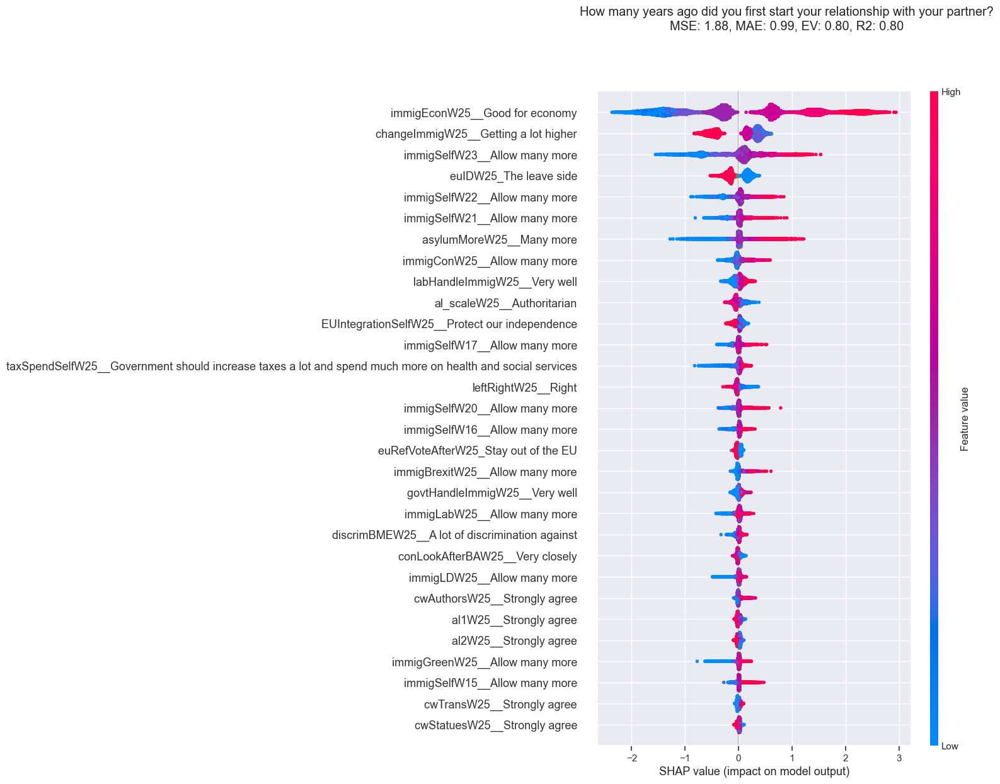

Wall time: 8min 12s


In [26]:
%%time
name="immigSelfW25__Allow many more"

# BES_num[name] = BES_Panel[name].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan).loc[BES_num.index]
df, corr_type = make_corr_summary(BES_reduced_with_na, name)
display_corr(df,name,corr_type)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name],verbosity=0)

In [27]:
## save BES_reduced_with_na as with floats!
BES_data_folder

'..\\BES_analysis_data\\'

In [30]:
BES_data_folder+dataset_name+os.sep+"BES_reduced_with_na.zip"

'..\\BES_analysis_data\\W25_comb\\BES_reduced_with_na.zip'

In [31]:
BES_reduced_with_na.to_pickle(BES_data_folder+dataset_name+os.sep+"BES_reduced_with_na.zip",compression='zip')

In [46]:
## find variables matching wave 25 and wave 24, make deltas

BES_delta = pd.DataFrame()

for ind_var in search(BES_reduced_with_na,".*W25_").index:
    # just look one wave back
    earlier_var = ind_var.replace("W25","W24")
    if earlier_var in BES_reduced_with_na.columns:
        delta_var = ind_var.replace("W25","(W24->W25)")
        BES_delta[delta_var] = BES_reduced_with_na[ind_var] - BES_reduced_with_na[earlier_var]

In [49]:
BES_reduced_with_na[BES_delta.columns]=BES_delta

,r,p,N
immigSelfW23__Allow many more,0.830000,0.00,17180
asylumMoreW25__Many more,0.820000,0.00,6646
immigEconW25__Good for economy,0.810000,0.00,26683
immigCulturalW20__Enriches cultural life,0.710000,0.00,12472
familiesMoreW25__Many more,0.690000,0.00,6646
globalMigrationW21__Mainly good,0.640000,0.00,2909
euMoreW25__Many more,0.620000,0.00,6750
warmSyriansW11__Very warm,0.610000,0.00,2366
immigrationLevelW6__Increased a lot,0.610000,0.00,7484
noneuMoreW25__Many more,0.600000,0.00,6684


MSE: 0.93, MAE: 0.56, EV: 0.90, R2: 0.90


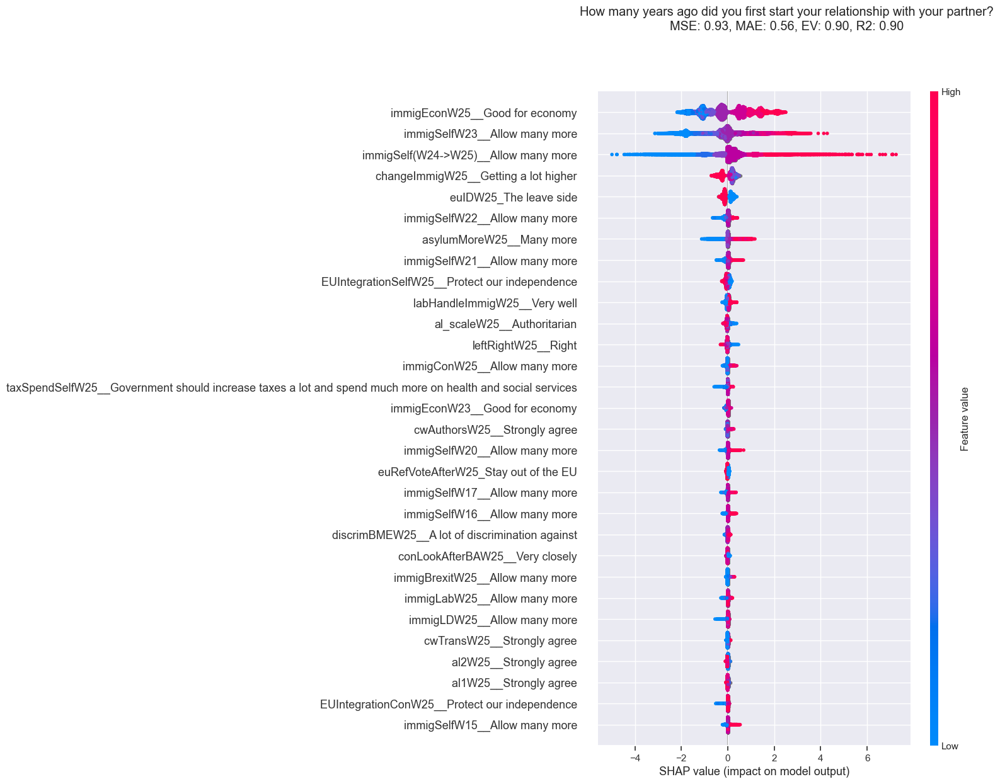

Wall time: 12min 41s


In [50]:
%%time
name="immigSelfW25__Allow many more"
stub="immigSelf"

# BES_num[name] = BES_Panel[name].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan).loc[BES_num.index]
df, corr_type = make_corr_summary(BES_reduced_with_na, name)
display_corr(df,name,corr_type)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

,r,p,N
immigSelfW23__Allow many more,0.830000,0.00,17180
asylumMoreW25__Many more,0.820000,0.00,6646
immigEconW25__Good for economy,0.810000,0.00,26683
immigCulturalW20__Enriches cultural life,0.710000,0.00,12472
familiesMoreW25__Many more,0.690000,0.00,6646
globalMigrationW21__Mainly good,0.640000,0.00,2909
euMoreW25__Many more,0.620000,0.00,6750
warmSyriansW11__Very warm,0.610000,0.00,2366
immigrationLevelW6__Increased a lot,0.610000,0.00,7484
noneuMoreW25__Many more,0.600000,0.00,6684


MSE: 2.08, MAE: 1.06, EV: 0.78, R2: 0.77


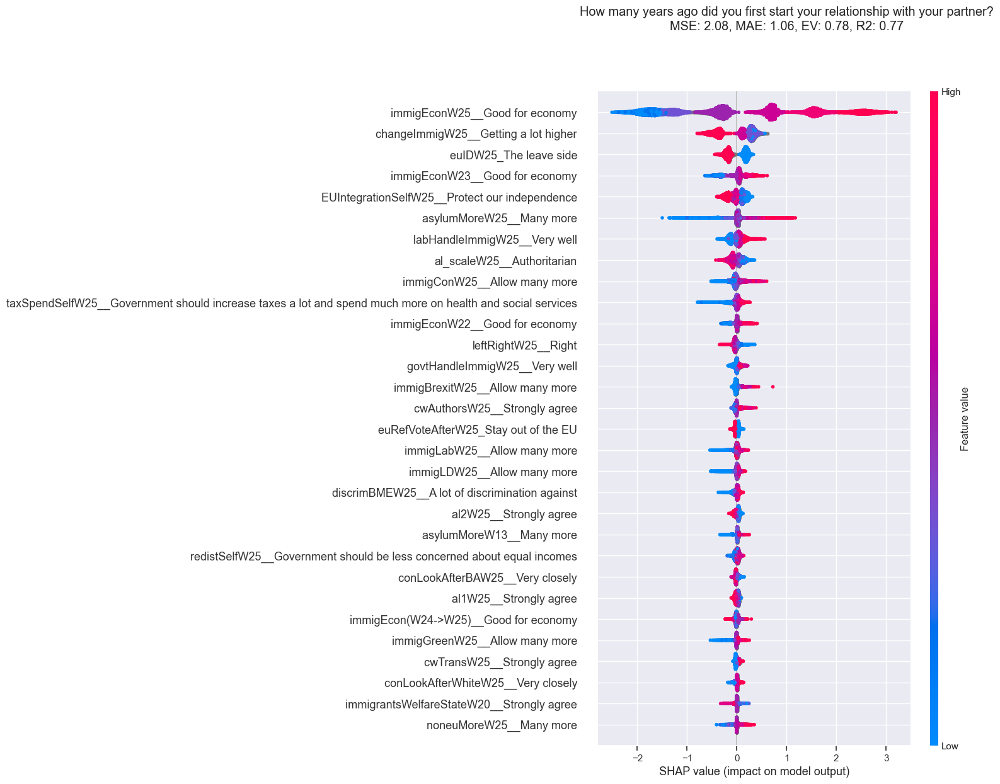

Wall time: 11min 2s


In [55]:
%%time
name="immigSelfW25__Allow many more"
stub="immigSelf"

# BES_num[name] = BES_Panel[name].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan).loc[BES_num.index]
df, corr_type = make_corr_summary(BES_reduced_with_na, name)
display_corr(df,name,corr_type)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

In [ ]:
# 8mins -> 11mins

In [ ]:
# need to handle multiwave WXWYWZ and WX_WY patterns

In [42]:
## Add all wave combinations?
## Start with Wx->W25

blah


In [ ]:
#     495         return df[[x for x in df.columns if re.search(pattern,x)]][mask].notnull().sum()
#     496     else:
# --> 497         return df[[x for x in df.columns if re.search(pattern, x, re.IGNORECASE)]][mask].notnull().sum()

In [6]:
### shouldn't use match/search - makes a copy of the dataframe! unnecessary for just selection columns!

changeImmigW1__Getting a lot higher         28952
changeImmigLabW1__Getting a lot higher      27027
immigEconW1__Good for economy               29096
immigCulturalW1__Enriches cultural life     29366
immigrantsWelfareStateW1__Strongly agree    29485
                                            ...  
small_mii_cat(W20->W25)_Immigration         12591
small_mii_cat(W21->W25)_Immigration         13645
small_mii_cat(W22->W25)_Immigration         14556
small_mii_cat(W23->W25)_Immigration         17027
small_mii_cat(W24->W25)_Immigration          9654
Length: 439, dtype: int64

In [3]:
# flatten = lambda l: [item for sublist in l for item in sublist]

# def match(df, pattern, case_sensitive=False, mask=None):
#     if mask is None:
#            mask = pd.Series(np.ones( (df.shape[0]) ) , index=df.index).astype('bool')
#     if case_sensitive:
#         return df.loc[mask,[x for x in df.columns if re.match(pattern, x)]].notnull().sum()
#     else:
#         return df.loc[mask,[x for x in df.columns if re.match(pattern, x, re.IGNORECASE)]].notnull().sum()

# def search(df, pattern, case_sensitive=False, mask=None):
#     if mask is None:
#         mask = pd.Series(np.ones( (df.shape[0]) ), index=df.index).astype('bool')
#     if case_sensitive:
#         return df.loc[mask,[x for x in df.columns if re.search(pattern, x)]].notnull().sum()
#     else:
#         return df.loc[mask,[x for x in df.columns if re.search(pattern, x, re.IGNORECASE)]].notnull().sum()

In [19]:
# %%time
## find variables matching wave 25 and wave 24, make deltas

BES_delta = pd.DataFrame()

for ind_var in search(BES_reduced_with_na,".*W25_").index:
    # just look one wave back
    for prior_wave in ["W"+str(x) for x in range(16,25)]:
        earlier_var = ind_var.replace("W25",prior_wave)
        if earlier_var in BES_reduced_with_na.columns:
            delta_var = ind_var.replace("W25","("+prior_wave+"->W25)")
            BES_reduced_with_na[delta_var] = BES_reduced_with_na[ind_var] - BES_reduced_with_na[earlier_var]
            

absorbed delta


,r,p,N
immigSelfW23__Allow many more,0.830000,0.00,17180
asylumMoreW25__Many more,0.820000,0.00,6646
immigEconW25__Good for economy,0.810000,0.00,26683
immigCulturalW20__Enriches cultural life,0.710000,0.00,12472
familiesMoreW25__Many more,0.690000,0.00,6646
globalMigrationW21__Mainly good,0.640000,0.00,2909
euMoreW25__Many more,0.620000,0.00,6750
immigrationLevelW6__Increased a lot,0.610000,0.00,7484
warmSyriansW11__Very warm,0.610000,0.00,2366
studentsMoreW25__Many more,0.600000,0.00,6600


MSE: 2.08, MAE: 1.06, EV: 0.77, R2: 0.77


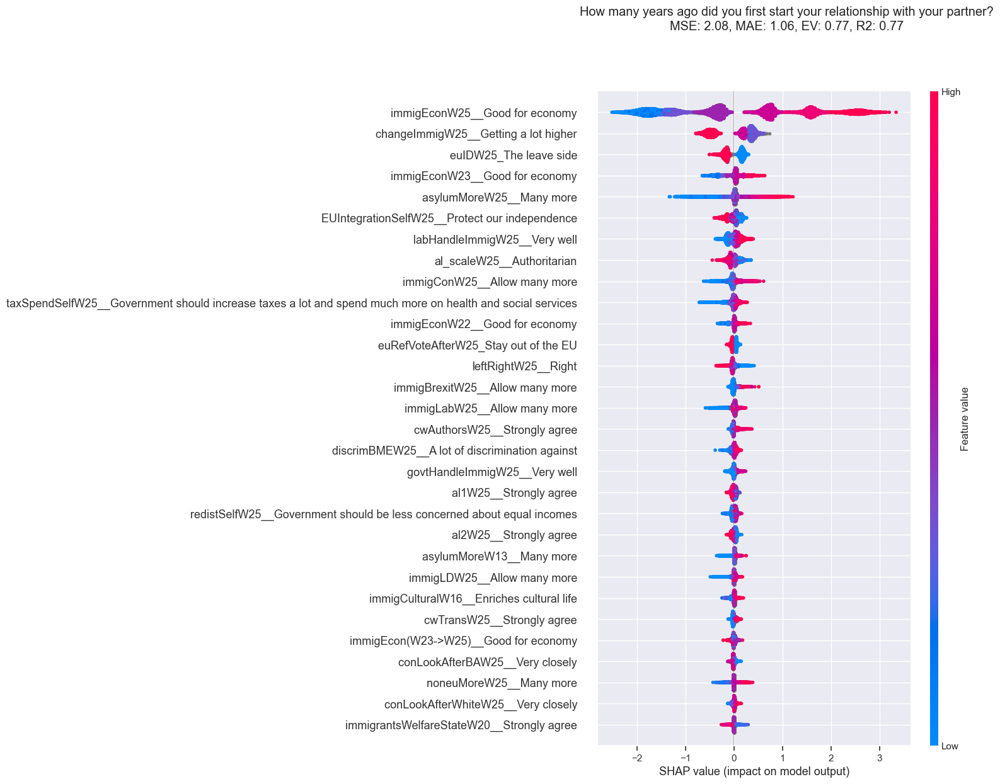

In [4]:
# BES_reduced_with_na[BES_delta.columns]=BES_delta

print("absorbed delta")

name="immigSelfW25__Allow many more"
stub="immigSelf"

# BES_num[name] = BES_Panel[name].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan).loc[BES_num.index]
df, corr_type = make_corr_summary(BES_reduced_with_na, name)
display_corr(df,name,corr_type)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

MSE: 2.66, MAE: 1.13, EV: 0.12, R2: 0.12


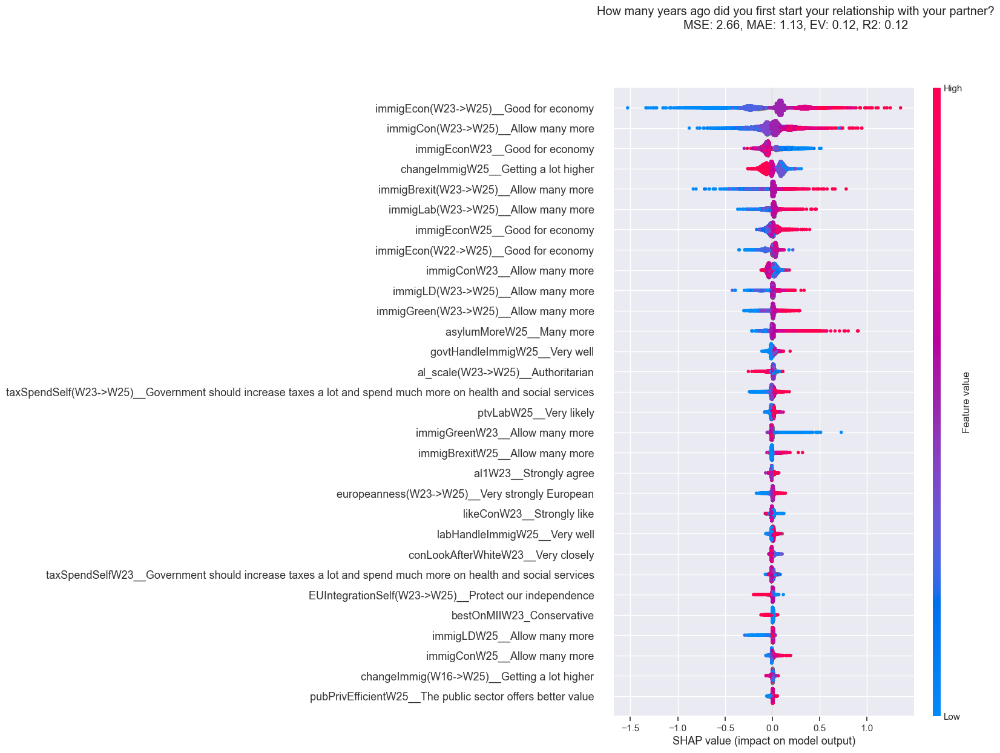

Wall time: 4min 9s


In [13]:
%%time
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

MSE: 0.40, MAE: 0.35, EV: 0.87, R2: 0.87


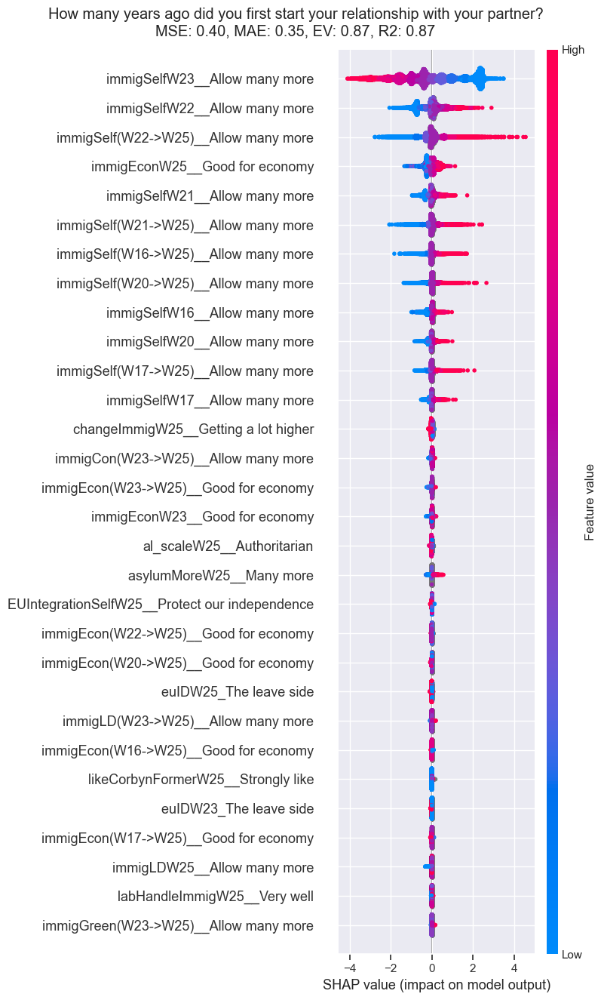

Wall time: 9min 20s


In [15]:
%%time
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelfW25"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

In [ ]:
## maybe verbose output notes how large train dataset is? / memory usage!

In [ ]:
######### Sunday exercise

# primary issue - signal **feels* weak for regression agasint +/- transitions

# measured on this basis
# MSE: 2.66, MAE: 1.13, EV: 0.12, R2: 0.12

# try to improve on this with different treatments focused on masking source values (immigSelfW23)
# or transforming the target (immigSelf(W23->W25) value

MSE: 2.66, MAE: 1.13, EV: 0.12, R2: 0.12


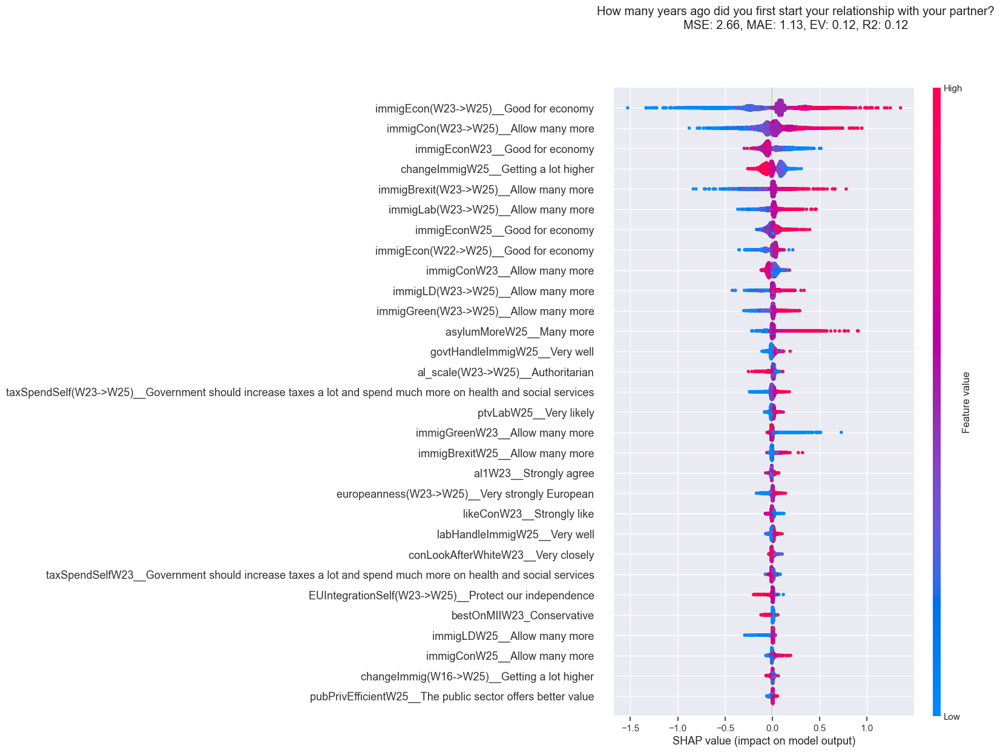

Wall time: 3min 6s


In [20]:
%%time
# repeat the 'control' treatment


name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

In [21]:
immig_temp = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].copy()

In [26]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].apply(lambda x: np.abs(x)*x)
#.value_counts()

MSE: 62.63, MAE: 3.57, EV: 0.06, R2: 0.06


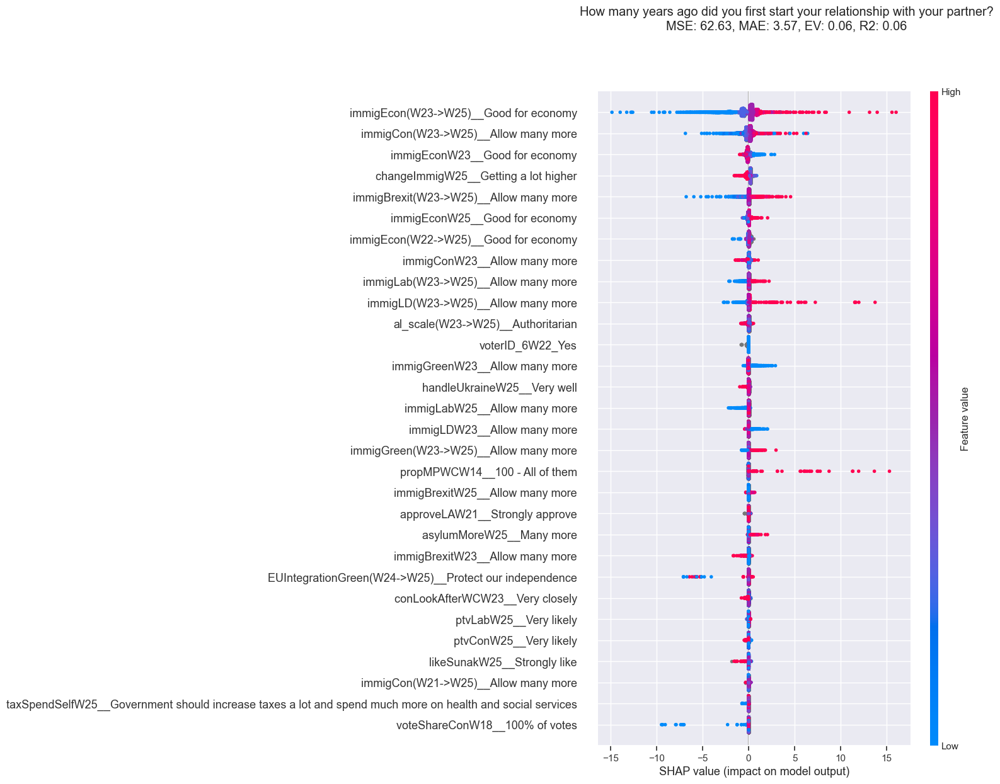

Wall time: 2min 10s


In [27]:
%%time
# now with immigSelf(W23->W25)... replace with x * |x|
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## worse!

In [28]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply(lambda x: x/np.sqrt(np.abs(x)))

MSE: 1.45, MAE: 1.02, EV: 0.18, R2: 0.18


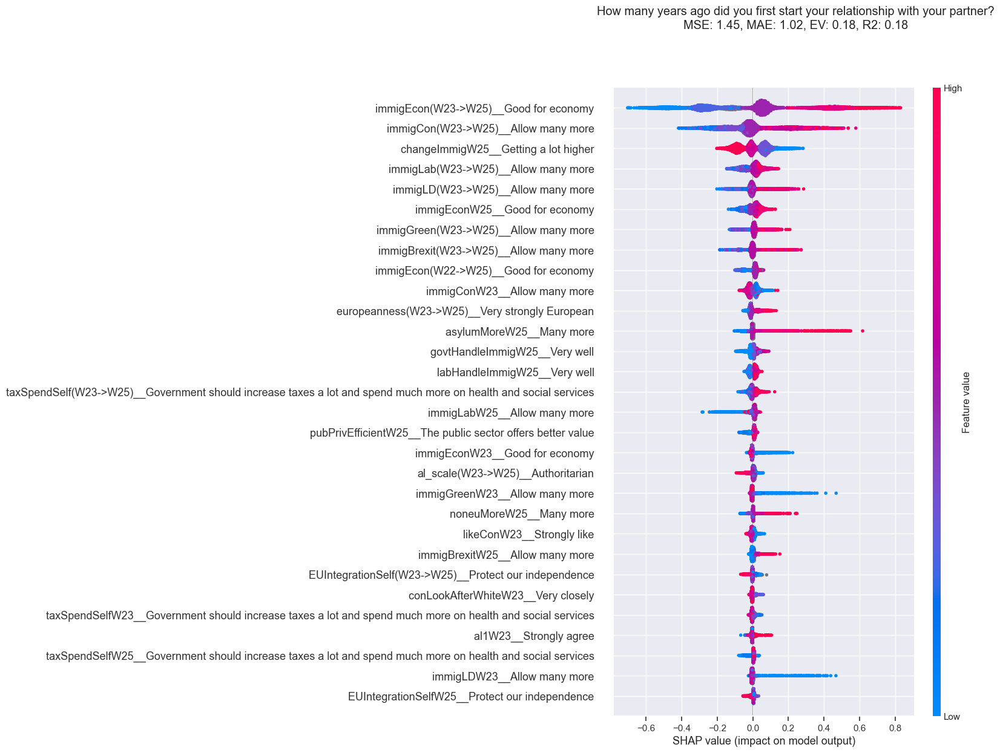

Wall time: 2min 23s


In [30]:
%%time
# now with immigSelf(W23->W25)... replace with x /sqrt(|x|)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## better!
# remind me - just what operations is R2/variance invariant to? 

In [34]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply(lambda x: x/np.abs(x) if x!=0 else 0)
# hard reduction to -1/0/1
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

 0.0    7338
-1.0    6535
 1.0    3307
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 0.48, MAE: 0.57, EV: 0.10, R2: 0.10


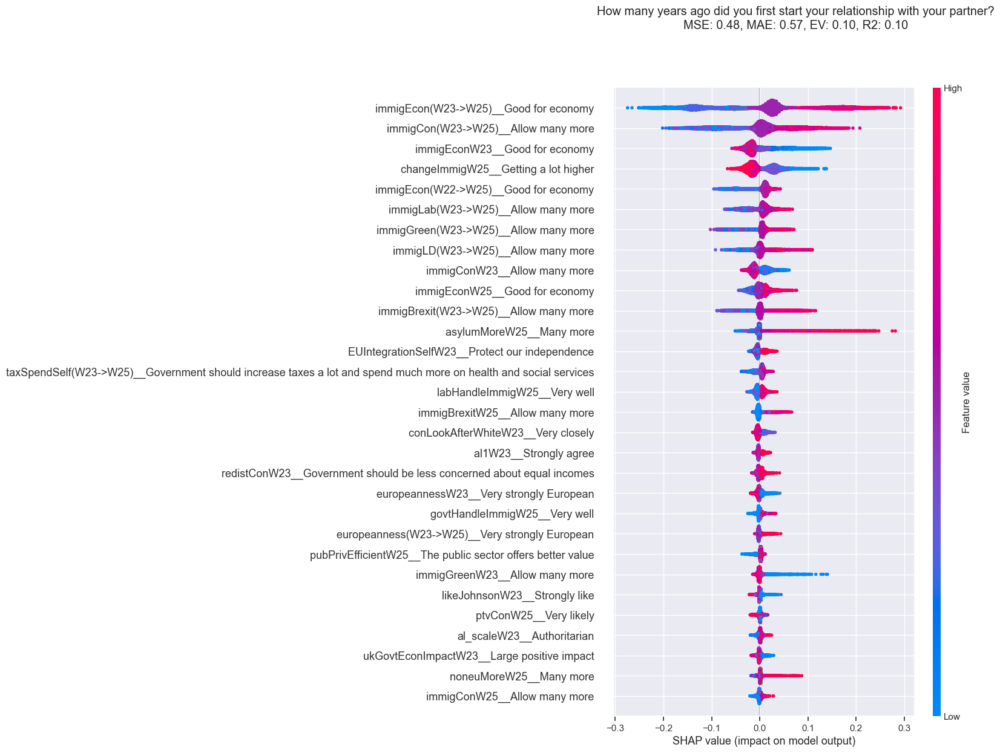

Wall time: 2min 49s


In [35]:
%%time
# now with immigSelf(W23->W25)... replace with x / |x|
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## worse  - as you'd expect for throwing data away

In [36]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply(lambda x: 10**x)
# raise to power of 10
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

1.000000e+00    7338
1.000000e-01    2863
1.000000e-02    1922
1.000000e+01    1744
1.000000e-03     984
1.000000e+02     918
1.000000e+03     356
1.000000e-05     319
1.000000e-04     318
1.000000e+05     107
1.000000e+04     107
1.000000e-06      54
1.000000e-07      37
1.000000e+06      33
1.000000e+07      19
1.000000e-10      17
1.000000e-08      17
1.000000e+10      14
1.000000e+08       5
1.000000e+09       4
1.000000e-09       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 70299415256927464.00, MAE: 8936206.76, EV: 0.01, R2: 0.01


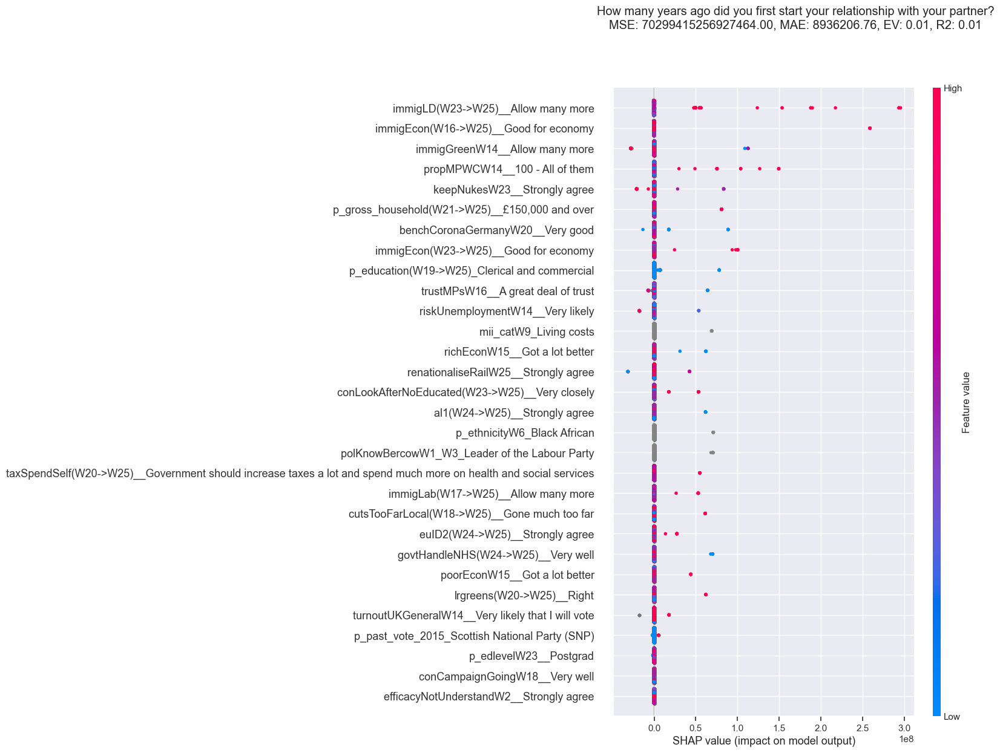

Wall time: 1min 6s


In [37]:
%%time
# now with immigSelf(W23->W25)... replace with 10**x
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## should be worse - stretching worsened it before, this is *extreme* stretching
# yep

In [39]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply(lambda x:np.log10(x+11))
# raise to power of 10
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

1.041393    7338
1.000000    2863
0.954243    1922
1.079181    1744
0.903090     984
1.113943     918
1.146128     356
0.778151     319
0.845098     318
1.204120     107
1.176091     107
0.698970      54
0.602060      37
1.230449      33
1.255273      19
0.477121      17
0.000000      17
1.322219      14
1.278754       5
0.301030       4
1.301030       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 0.01, MAE: 0.05, EV: 0.11, R2: 0.11


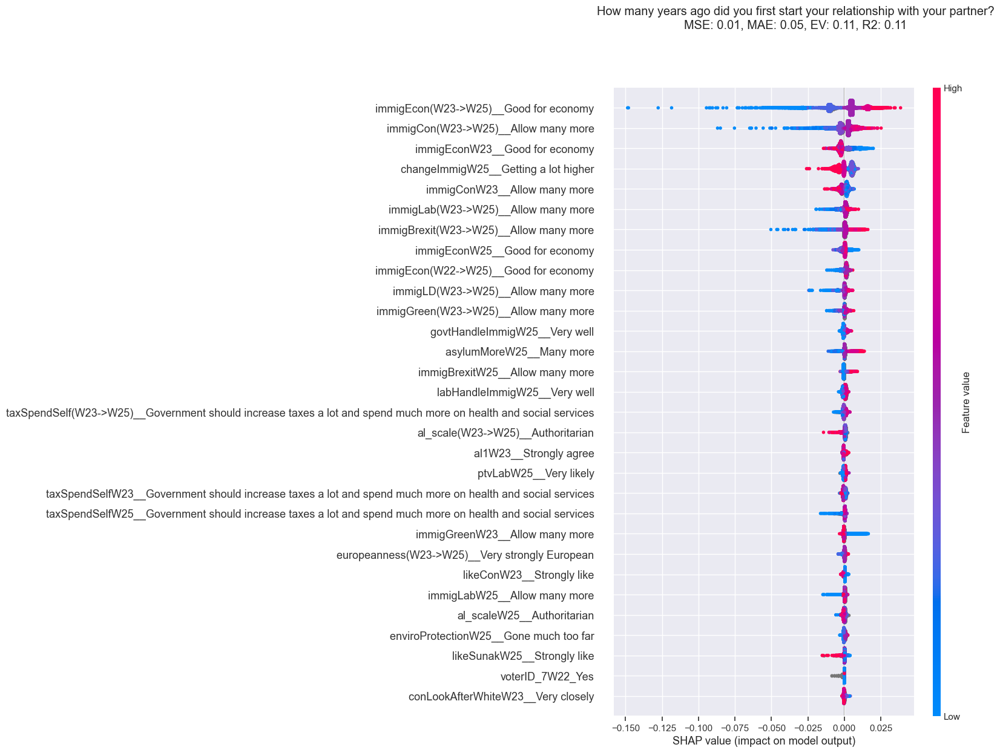

Wall time: 4min 30s


In [40]:
%%time
# now with immigSelf(W23->W25)... replace with log(x)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## not as good as sqrt, but not significantly worse than vanilla

In [50]:
pd.qcut(immig_temp,100,duplicates='drop').value_counts().sort_index()

(-10.001, -5.0]     448
(-5.0, -4.0]        318
(-4.0, -3.0]        984
(-3.0, -2.0]       1922
(-2.0, -1.0]       2863
(-1.0, 0.0]        7338
(0.0, 1.0]         1744
(1.0, 2.0]          918
(2.0, 3.0]          356
(3.0, 5.0]          214
(5.0, 10.0]          75
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

In [56]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = pd.qcut(immig_temp,100,duplicates='drop').cat.codes.replace(-1,np.nan)
# raise to power of 10
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

5.0     7338
4.0     2863
3.0     1922
6.0     1744
2.0      984
7.0      918
0.0      448
8.0      356
1.0      318
9.0      214
10.0      75
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 2.32, MAE: 1.10, EV: 0.13, R2: 0.13


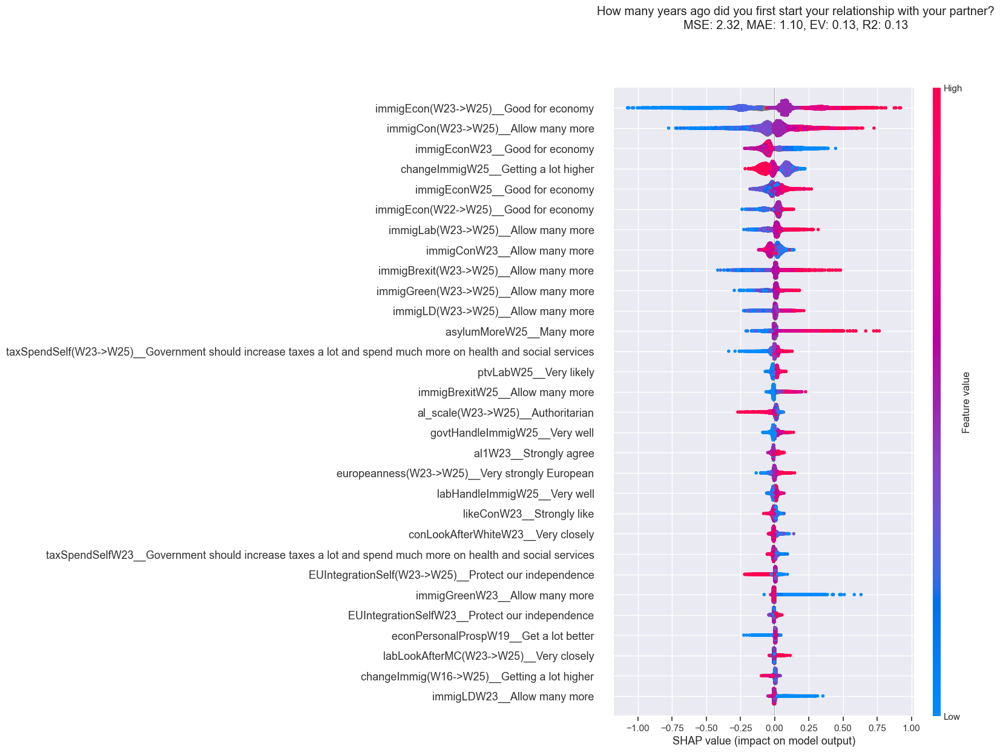

Wall time: 3min 33s


In [57]:
%%time
# now with x replaced with grouped values (100 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

## 

In [58]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = pd.qcut(immig_temp,10,duplicates='drop').cat.codes.replace(-1,np.nan)
# raise to power of 10
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

3.0    7338
2.0    2863
1.0    1922
0.0    1750
4.0    1744
5.0    1563
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 1.59, MAE: 0.97, EV: 0.13, R2: 0.13


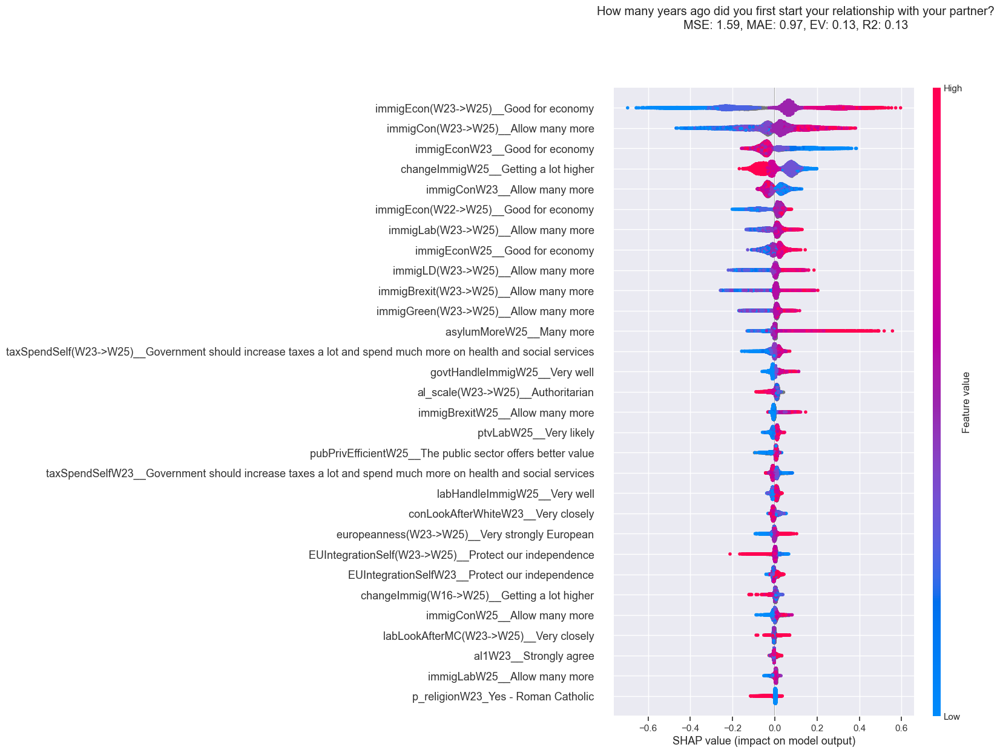

Wall time: 4min 3s


In [59]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [60]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.5) )
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.414214    1922
 1.000000    1744
-1.732051     984
 1.414214     918
 1.732051     356
-2.236068     319
-2.000000     318
 2.236068     107
 2.000000     107
-2.449490      54
-2.645751      37
 2.449490      33
 2.645751      19
-3.162278      17
-2.828427      17
 3.162278      14
 2.828427       5
-3.000000       4
 3.000000       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 1.45, MAE: 1.02, EV: 0.18, R2: 0.18


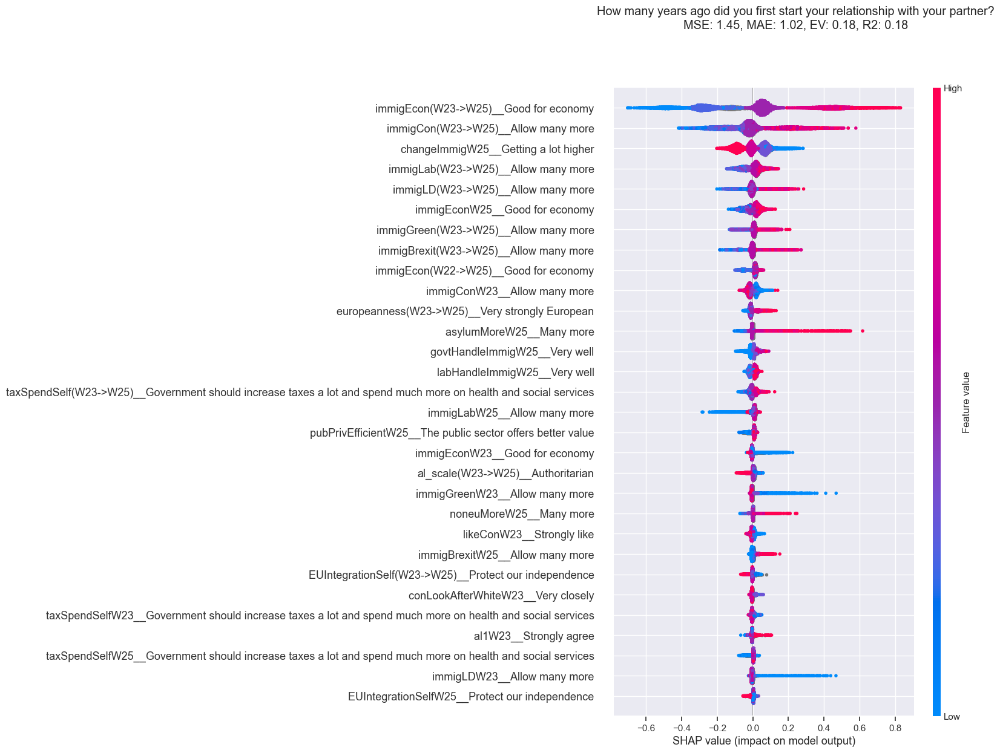

Wall time: 2min 14s


In [61]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [63]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.9))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.071773    1922
 1.000000    1744
-1.116123     984
 1.071773     918
 1.116123     356
-1.174619     319
-1.148698     318
 1.174619     107
 1.148698     107
-1.196231      54
-1.214814      37
 1.196231      33
 1.214814      19
-1.231144      17
-1.258925      17
 1.258925      14
 1.231144       5
-1.245731       4
 1.245731       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 0.84, MAE: 0.82, EV: 0.15, R2: 0.15


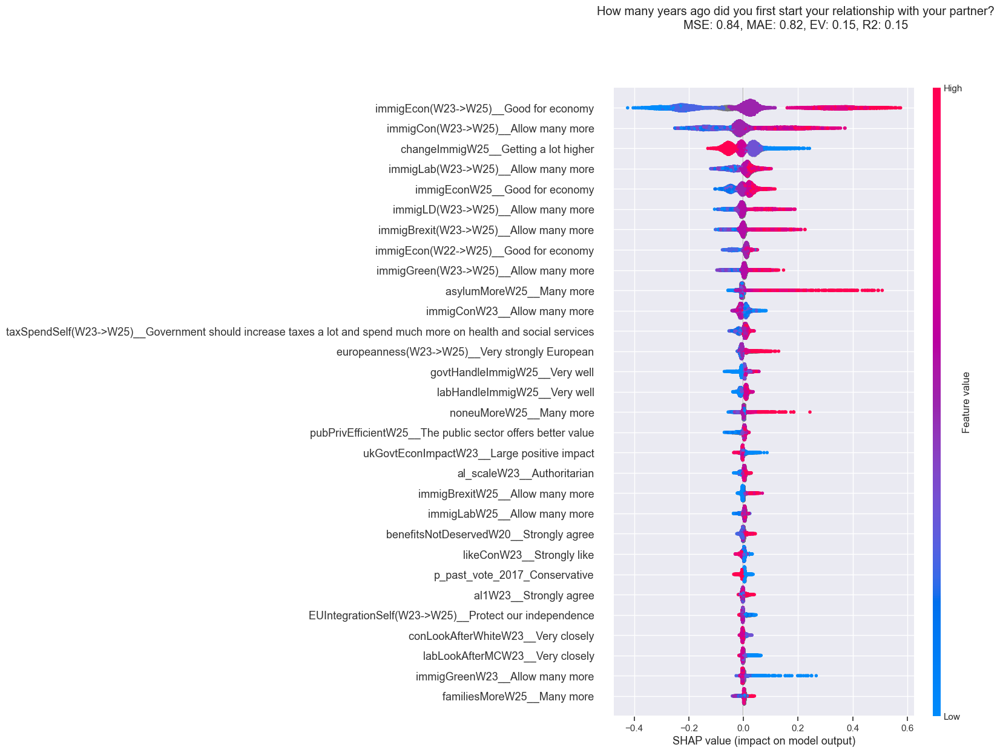

Wall time: 2min 4s


In [64]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [65]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.1))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.866066    1922
 1.000000    1744
-2.687875     984
 1.866066     918
 2.687875     356
-4.256700     319
-3.482202     318
 3.482202     107
 4.256700     107
-5.015753      54
-5.762199      37
 5.015753      33
 5.762199      19
-6.498019      17
-7.943282      17
 7.943282      14
 6.498019       5
-7.224674       4
 7.224674       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 3.33, MAE: 1.43, EV: 0.17, R2: 0.17


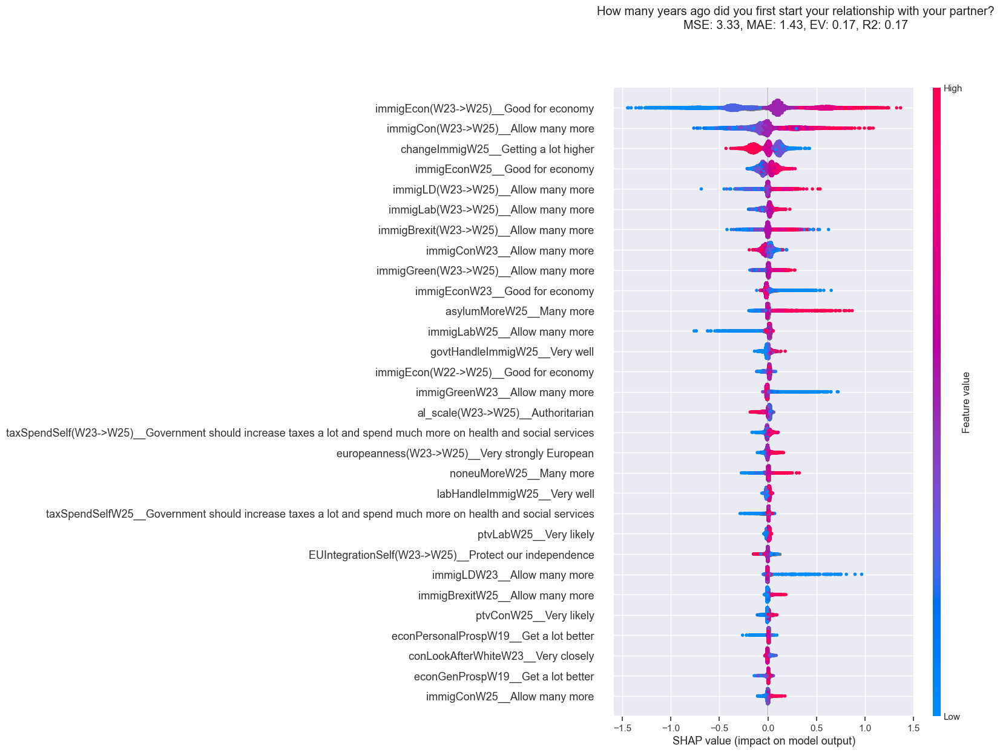

Wall time: 2min 25s


In [66]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [67]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.3))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.624505    1922
 1.000000    1744
-2.157669     984
 1.624505     918
 2.157669     356
-3.085169     319
-2.639016     318
 2.639016     107
 3.085169     107
-3.505144      54
-3.904529      37
 3.505144      33
 3.904529      19
-5.011872      17
-4.287094      17
 5.011872      14
 4.287094       5
 4.655537       4
-4.655537       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 2.12, MAE: 1.20, EV: 0.18, R2: 0.18


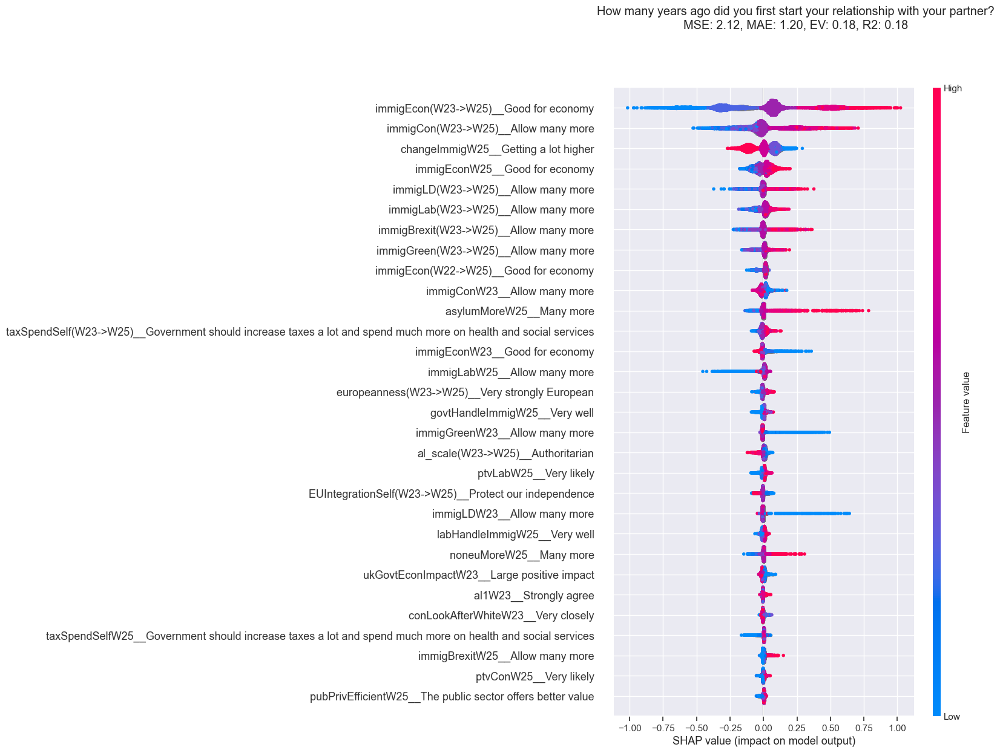

Wall time: 2min 8s


In [68]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [71]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.4))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.515717    1922
 1.000000    1744
-1.933182     984
 1.515717     918
 1.933182     356
-2.626528     319
-2.297397     318
 2.297397     107
 2.626528     107
-2.930156      54
-3.214096      37
 2.930156      33
 3.214096      19
-3.981072      17
-3.482202      17
 3.981072      14
 3.482202       5
-3.737193       4
 3.737193       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 1.74, MAE: 1.11, EV: 0.18, R2: 0.18


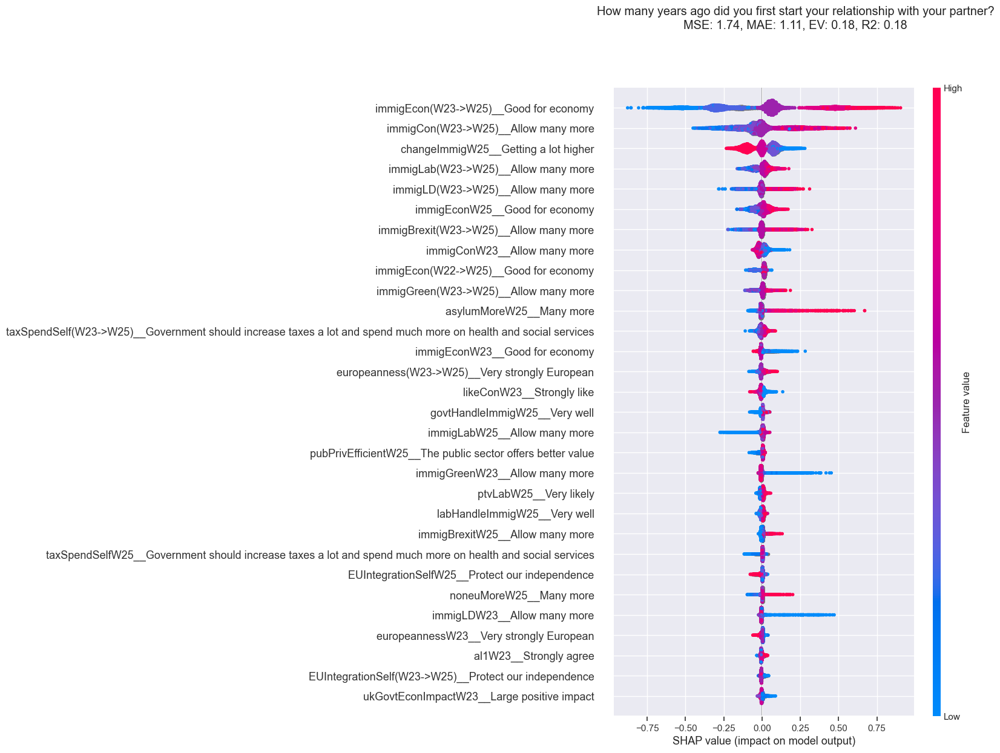

Wall time: 2min 11s


In [72]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [73]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.7))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.231144    1922
 1.000000    1744
-1.390389     984
 1.231144     918
 1.390389     356
-1.620657     319
-1.515717     318
 1.515717     107
 1.620657     107
-1.711770      54
-1.792790      37
 1.711770      33
 1.792790      19
-1.866066      17
-1.995262      17
 1.995262      14
 1.866066       5
-1.933182       4
 1.933182       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 1.07, MAE: 0.90, EV: 0.17, R2: 0.17


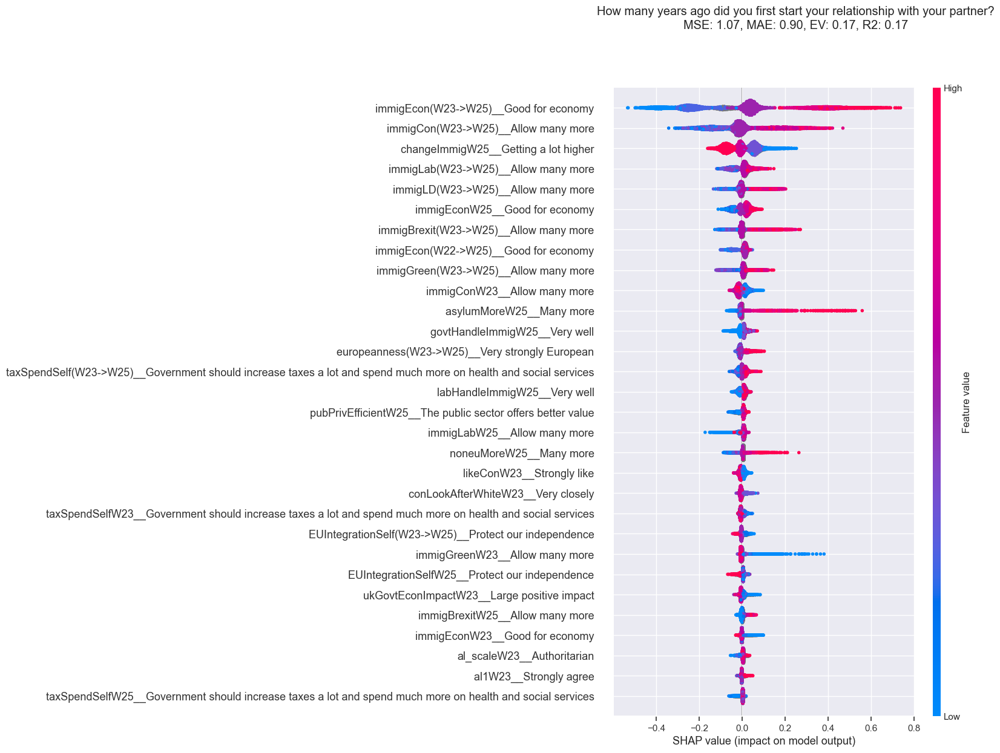

Wall time: 2min 23s


In [74]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub="immigSelf"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "How many years ago did you first start your relationship with your partner?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = [name,stub],verbosity=0)

##

In [ ]:
#### drop some high corr variables

In [75]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = immig_temp

BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"] = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]\
    .apply( lambda x: x/(np.abs(x)**.5))
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts()

-1.000000    2863
-1.414214    1922
 1.000000    1744
-1.732051     984
 1.414214     918
 1.732051     356
-2.236068     319
-2.000000     318
 2.236068     107
 2.000000     107
-2.449490      54
-2.645751      37
 2.449490      33
 2.645751      19
-3.162278      17
-2.828427      17
 3.162278      14
 2.828427       5
-3.000000       4
 3.000000       4
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

MSE: 1.58, MAE: 1.10, EV: 0.11, R2: 0.11


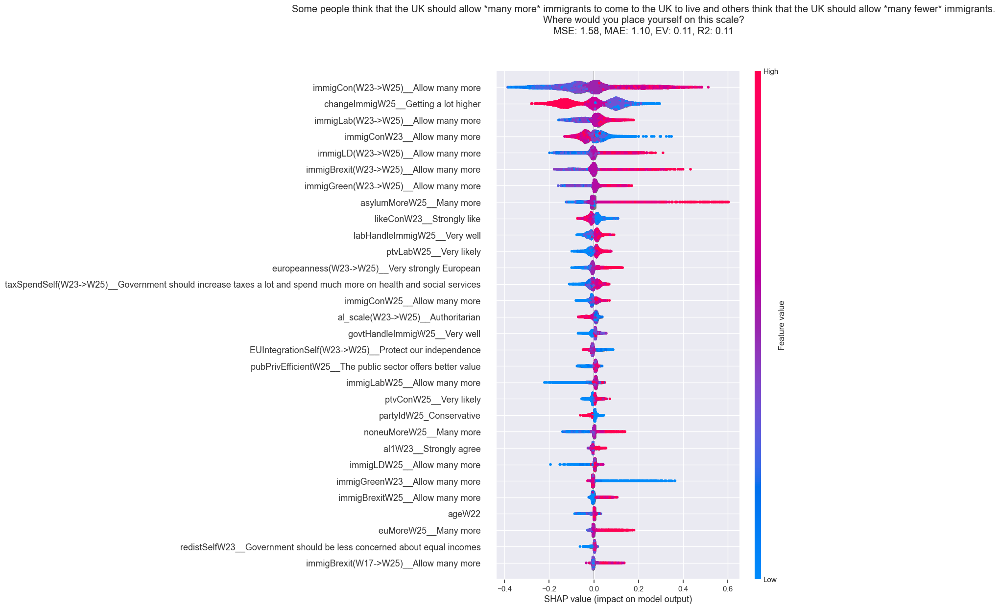

Wall time: 1min 58s


In [76]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.71, MAE: 1.18, EV: 0.03, R2: 0.03


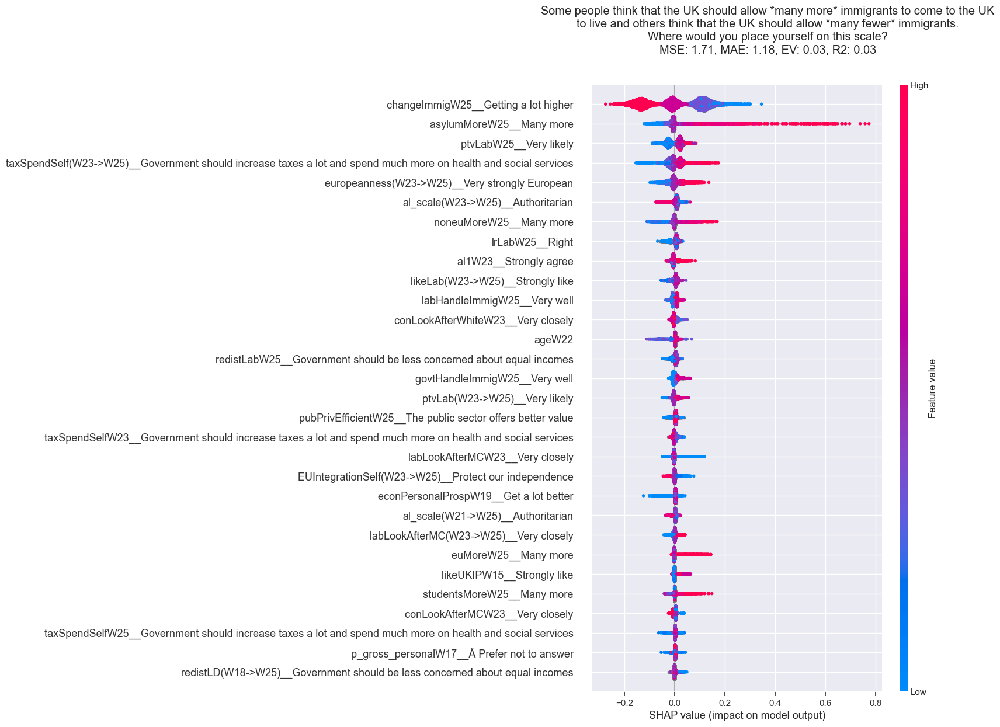

Wall time: 1min 31s


In [78]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon","immig"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.73, MAE: 1.19, EV: 0.02, R2: 0.02


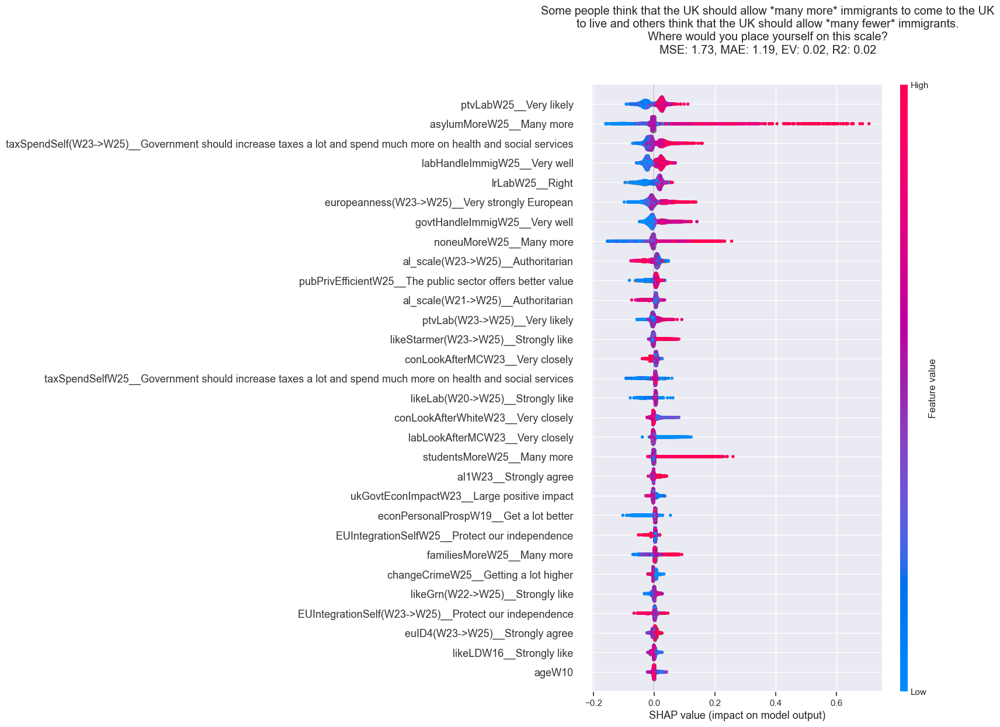

Wall time: 2min 1s


In [79]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon","immig","changeImmig"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.74, MAE: 1.19, EV: 0.01, R2: 0.01


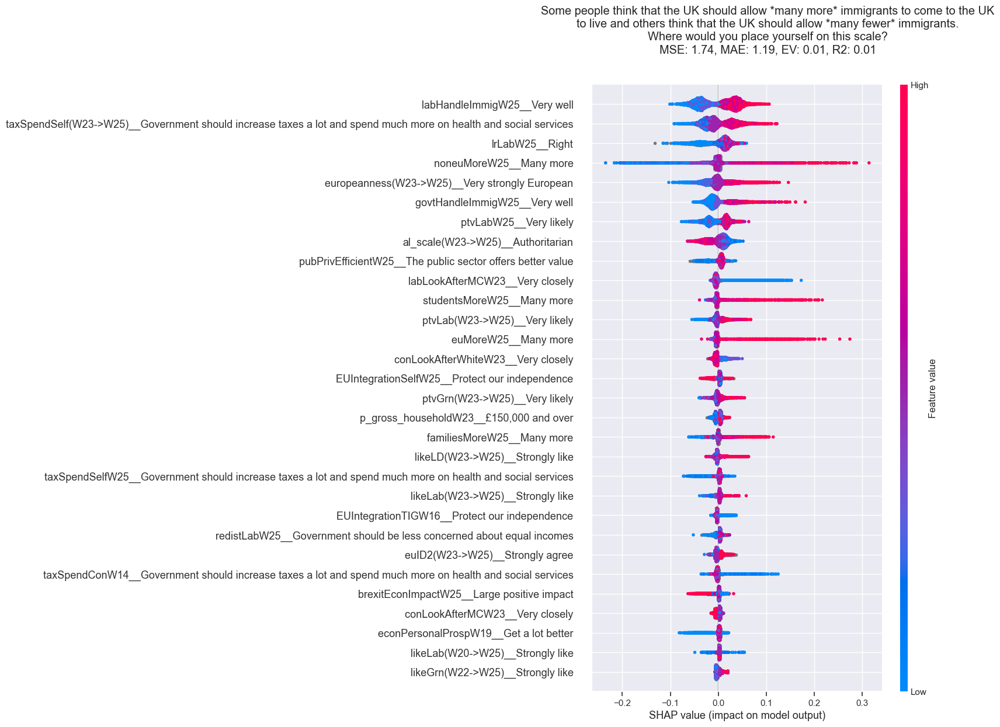

Wall time: 1min 16s


In [80]:
%%time
# now with x replaced with grouped values (10 original cats)
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon","immig","changeImmig","asylumMore"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [ ]:
#################

In [85]:
BES_reduced_with_na.index = BES_Panel.index

,waves_taken,wave1,wave2,wave3,wave4,wave5,wave6,wave7,wave8,wave9,...,p_edlevelUniW22,p_edlevelUniW23,p_edlevelUniW25,p_edlevelUniW8,p_edlevelUniW17,p_edlevelUniW18,p_eurefturnout,cogempathyIRTW14,affempathyIRTW14,zeroSumIRTW14
id,,,,,,,,,,,,,,,,,,,,,
1,9.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,Undergraduate,NaN,NaN,"Yes, voted",NaN,NaN,NaN
2,20.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,Undergraduate,Undergraduate,NaN,Undergraduate,Undergraduate,Undergraduate,"Yes, voted",NaN,NaN,NaN
3,16.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,NaN,A-level,NaN,NaN,NaN,NaN,"Yes, voted",NaN,NaN,NaN
4,2.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113062,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,GCSE,NaN,NaN,NaN,"No, did not vote",NaN,NaN,NaN
113063,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,GCSE,NaN,NaN,NaN,"No, did not vote",NaN,NaN,NaN
113064,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,A-level,NaN,NaN,NaN,"No, did not vote",NaN,NaN,NaN


In [94]:
BES_Panel["generalElectionVoteW25"].value_counts()

Labour                           9135
Conservative                     6039
Don't know                       5727
Liberal Democrat                 2415
I would/did not vote             2191
Green Party                      1516
Brexit Party/Reform UK           1437
Scottish National Party (SNP)     775
Other                             596
Plaid Cymru                       152
Name: generalElectionVoteW25, dtype: int64

MSE: 1.37, MAE: 0.98, EV: 0.20, R2: 0.20


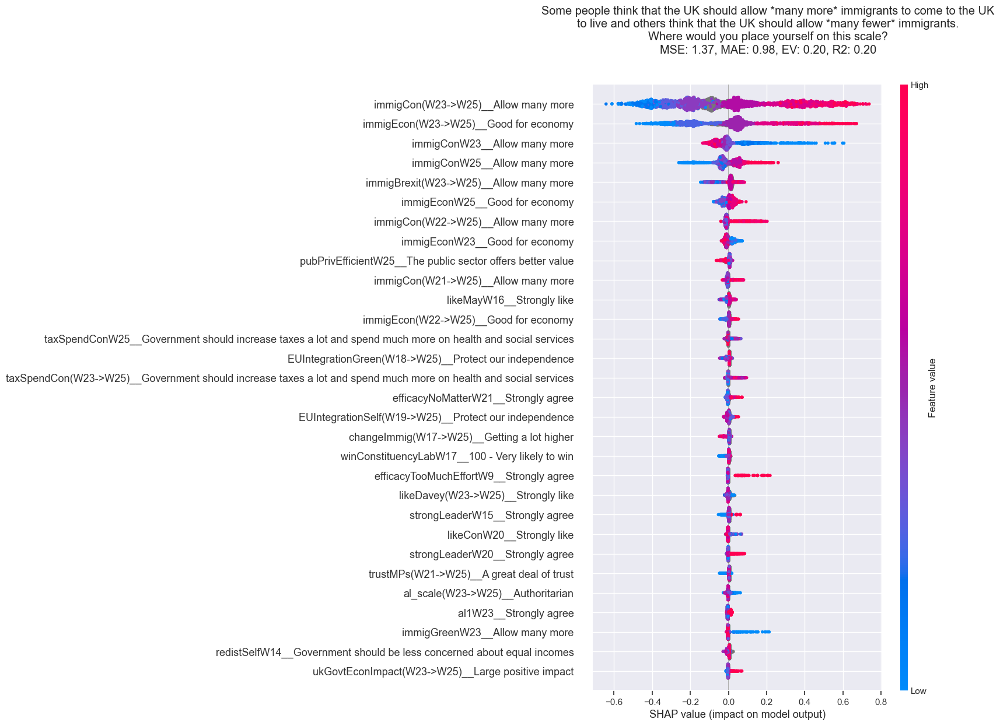

Wall time: 30 s


In [88]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="Conservative"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.60, MAE: 1.11, EV: 0.12, R2: 0.12


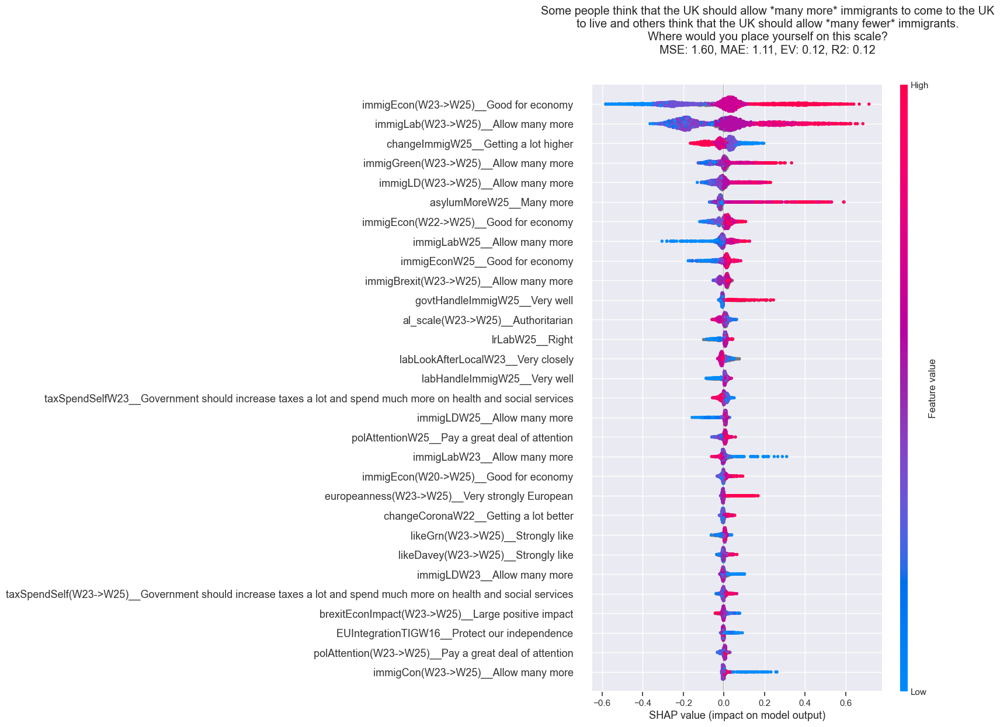

Wall time: 40.5 s


In [89]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="Labour"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.66, MAE: 1.12, EV: -0.01, R2: -0.02


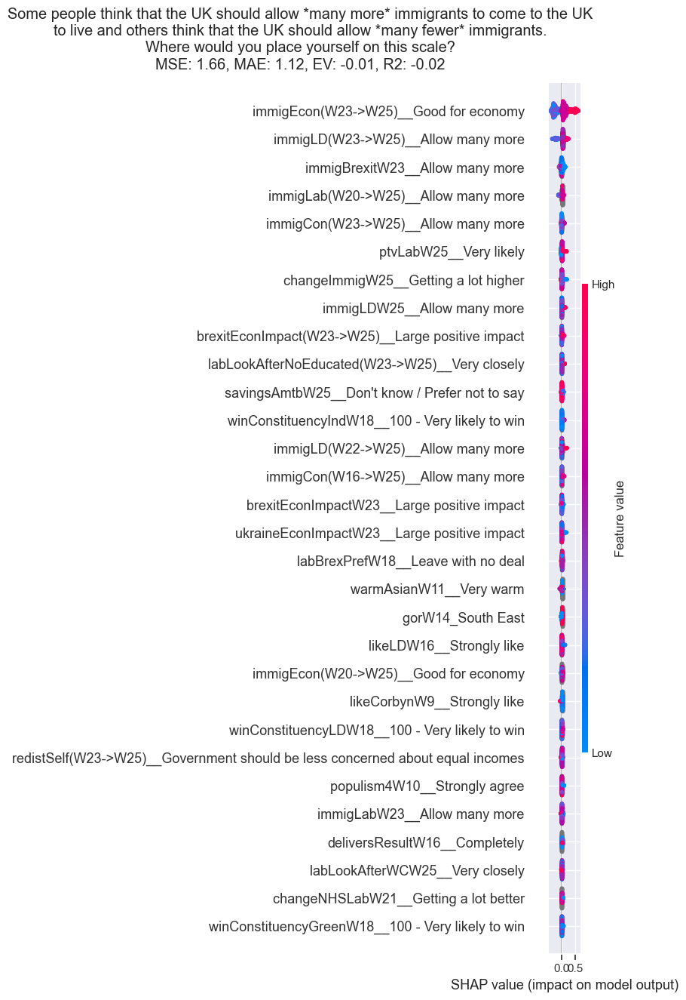

Wall time: 17.6 s


In [91]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="Liberal Democrat"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.56, MAE: 1.09, EV: 0.11, R2: 0.10


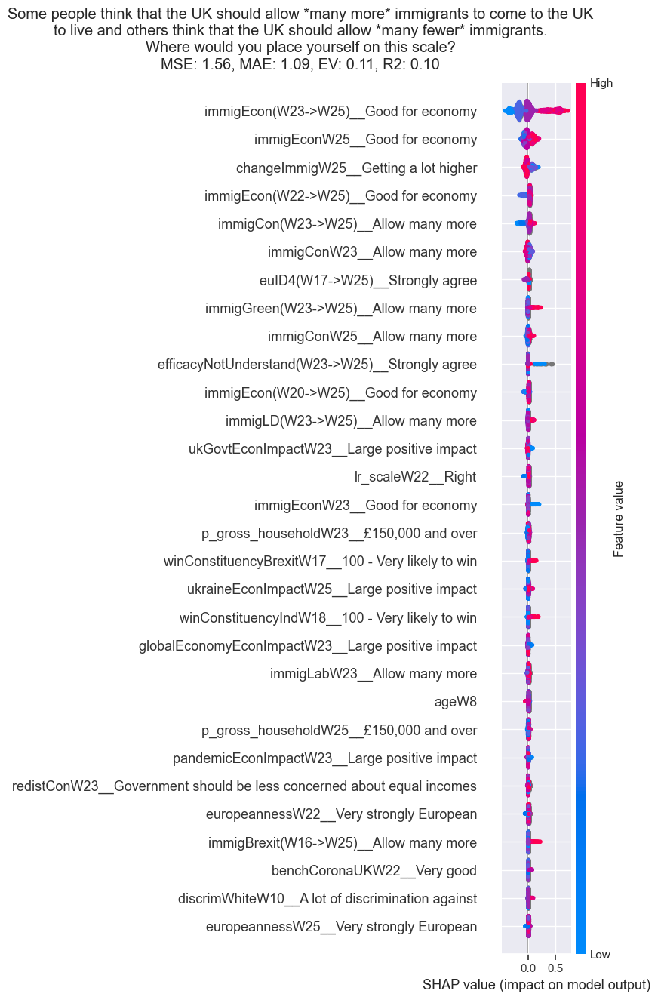

Wall time: 20.6 s


In [92]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="Don't know"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.73, MAE: 1.14, EV: 0.04, R2: 0.04


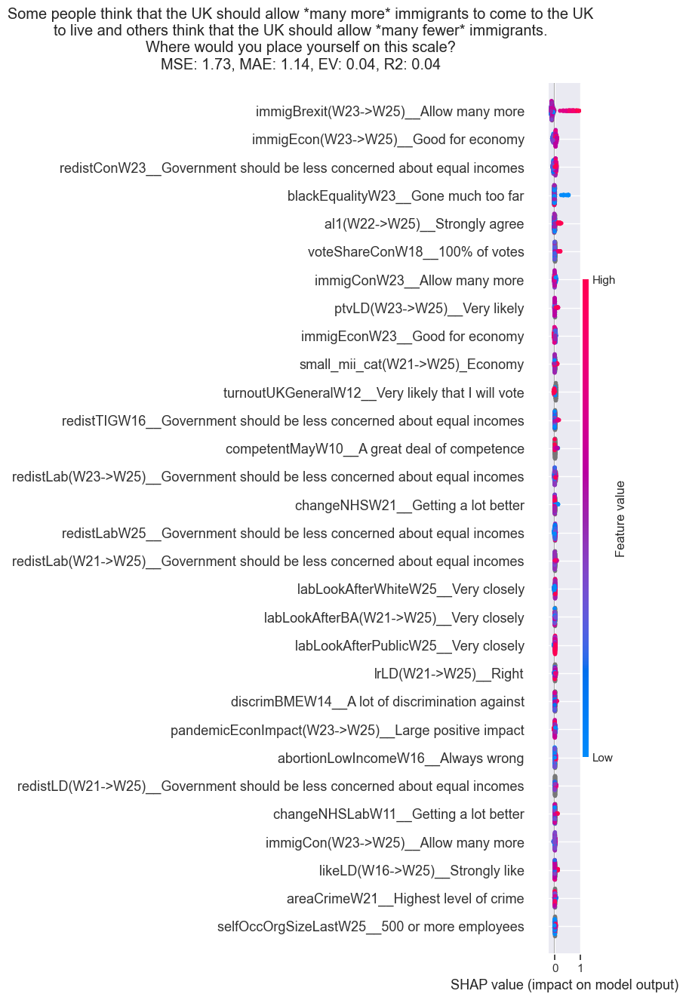

Wall time: 14.5 s


In [95]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="Brexit Party/Reform UK"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.91, MAE: 1.20, EV: 0.06, R2: 0.05


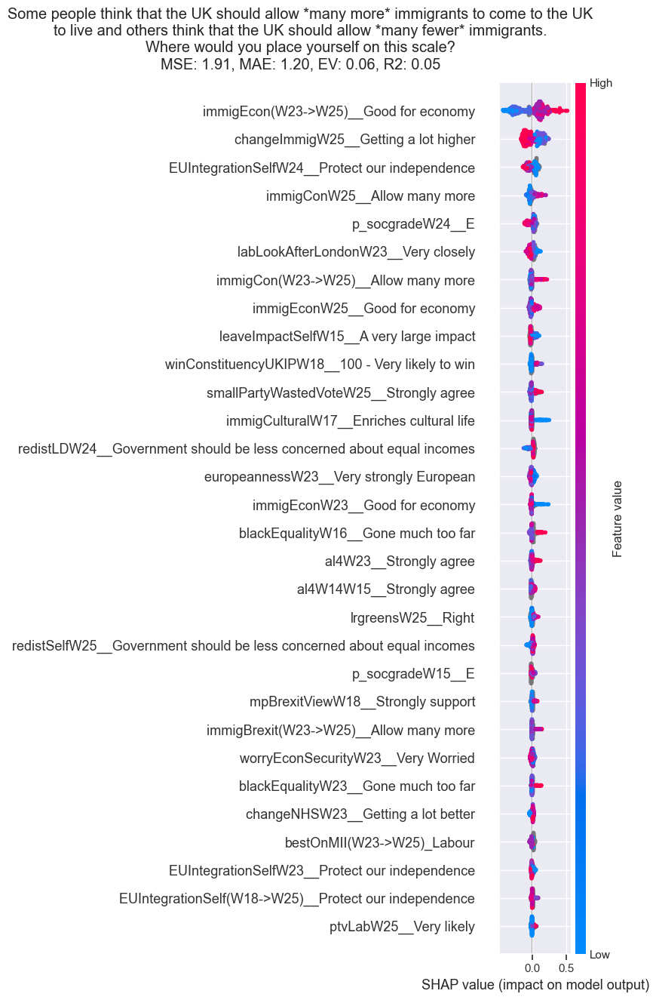

Wall time: 17.2 s


In [96]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_Panel["generalElectionVoteW25"]=="I would/did not vote"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.45, MAE: 1.02, EV: 0.18, R2: 0.18


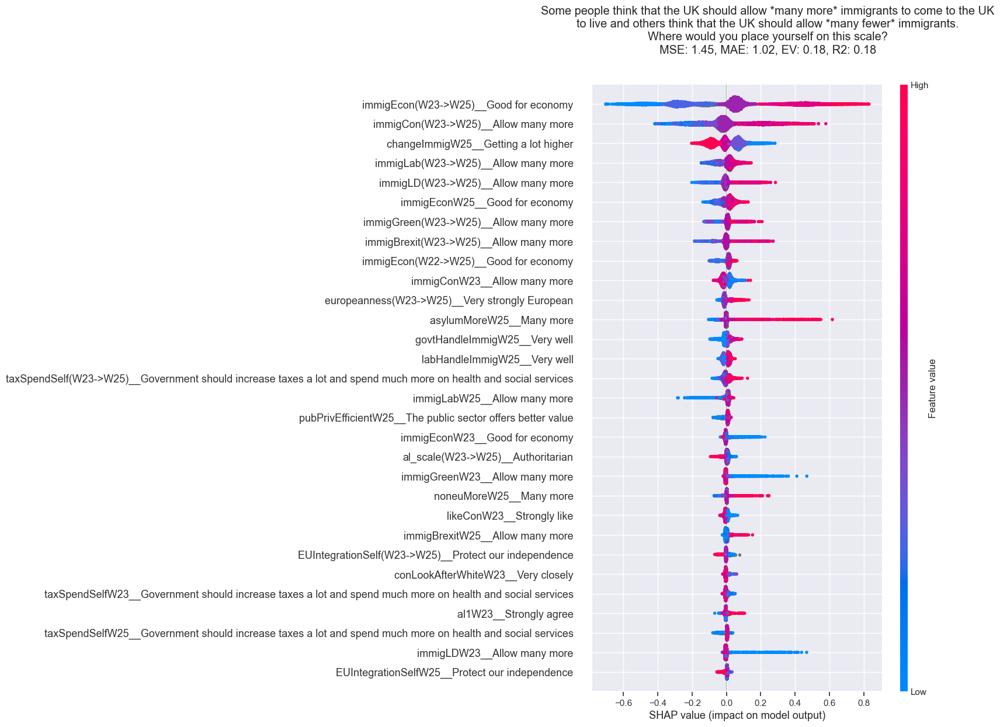

<Figure size 1600x1000 with 0 Axes>

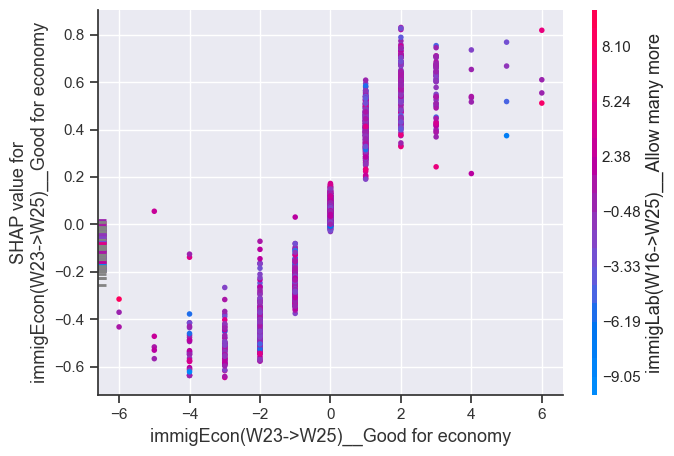

<Figure size 1600x1000 with 0 Axes>

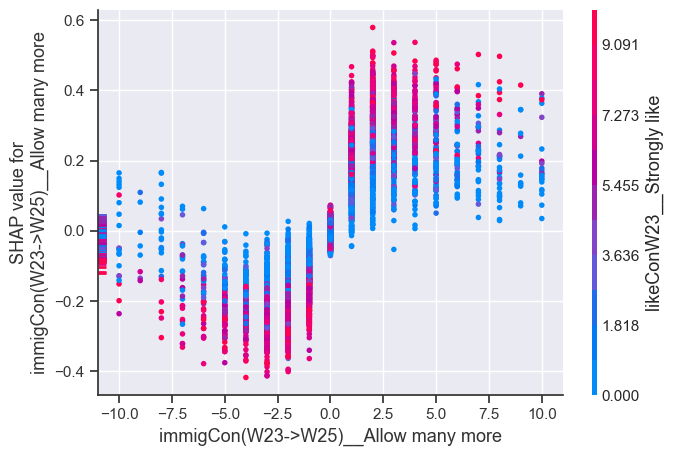

<Figure size 1600x1000 with 0 Axes>

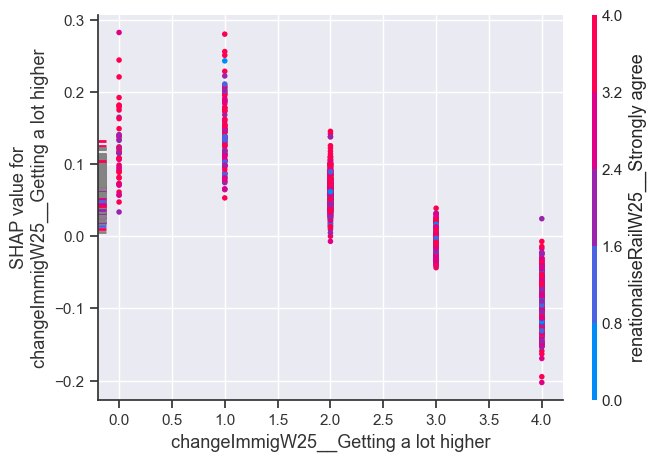

<Figure size 1600x1000 with 0 Axes>

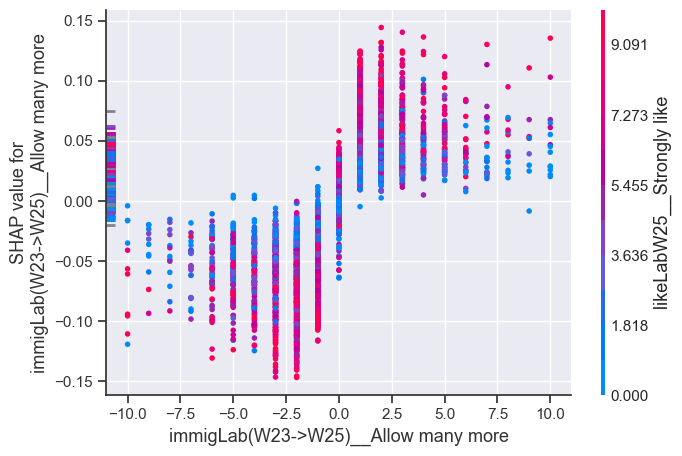

<Figure size 1600x1000 with 0 Axes>

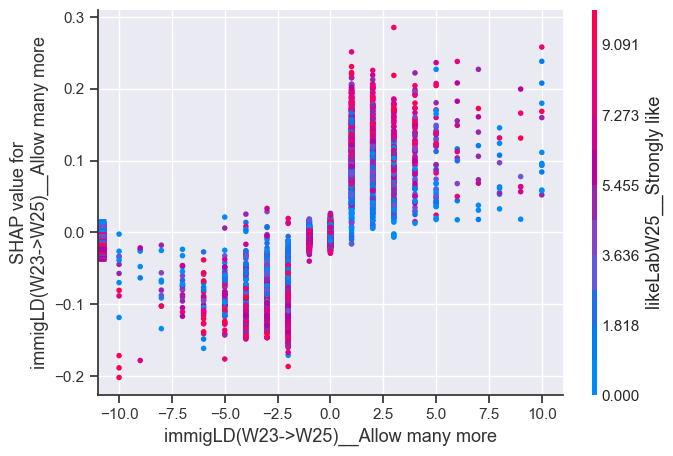

<Figure size 1600x1000 with 0 Axes>

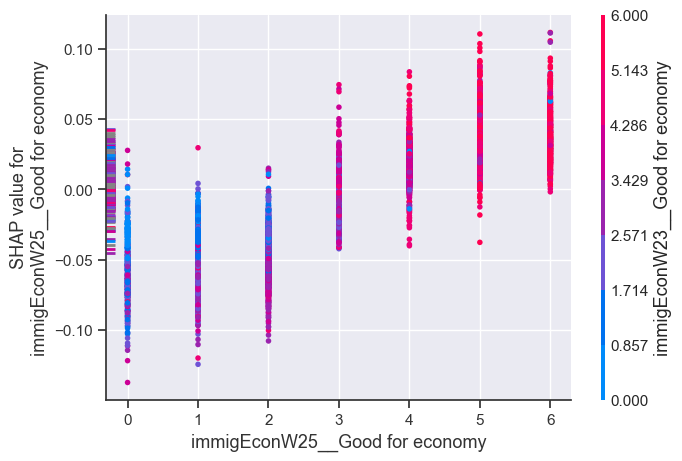

<Figure size 1600x1000 with 0 Axes>

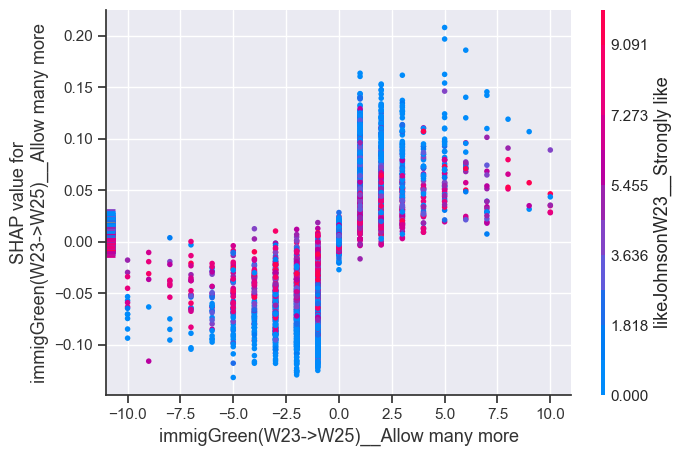

<Figure size 1600x1000 with 0 Axes>

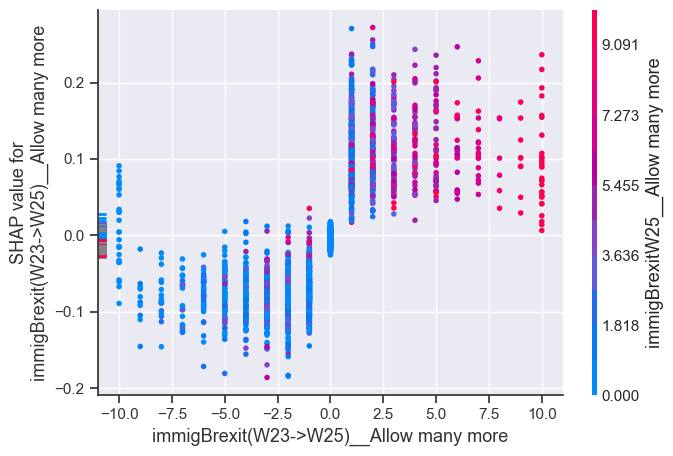

<Figure size 1600x1000 with 0 Axes>

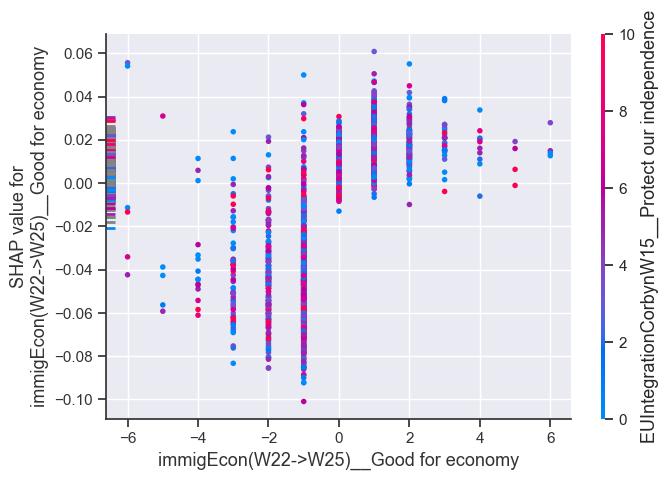

<Figure size 1600x1000 with 0 Axes>

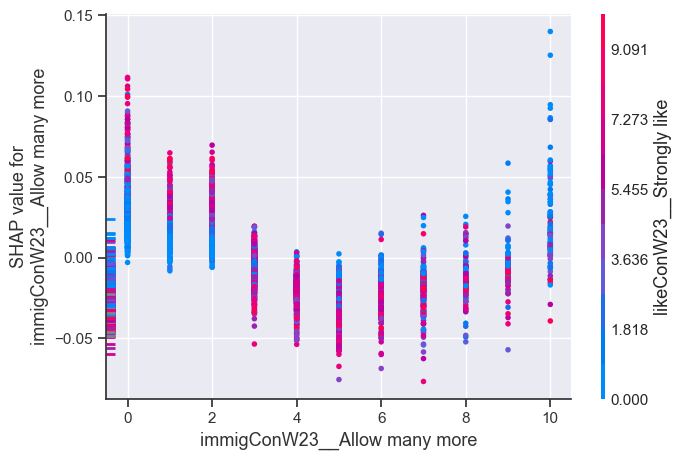

<Figure size 1600x1000 with 0 Axes>

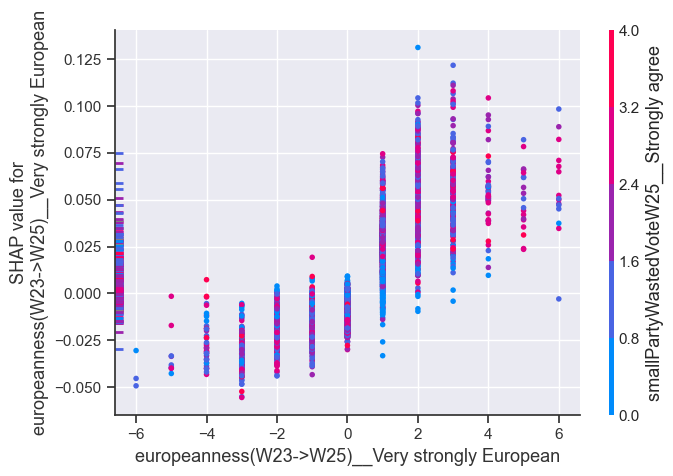

<Figure size 1600x1000 with 0 Axes>

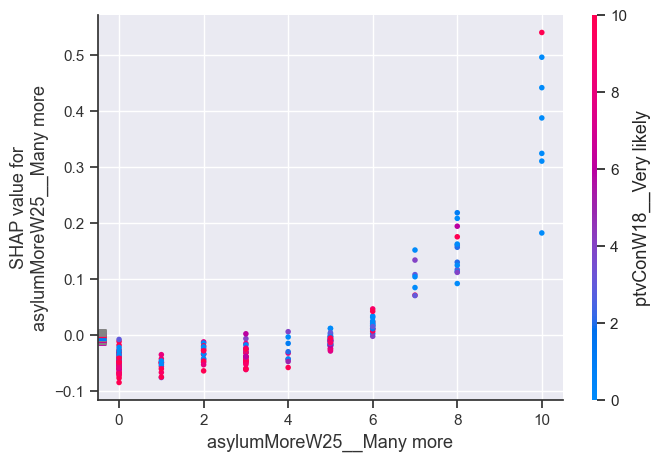

<Figure size 1600x1000 with 0 Axes>

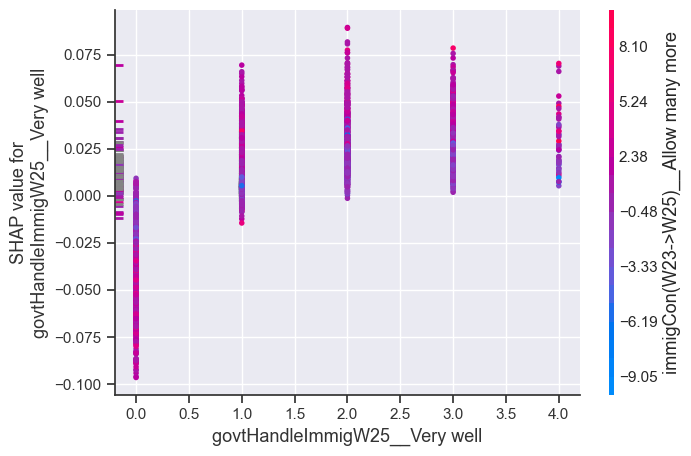

<Figure size 1600x1000 with 0 Axes>

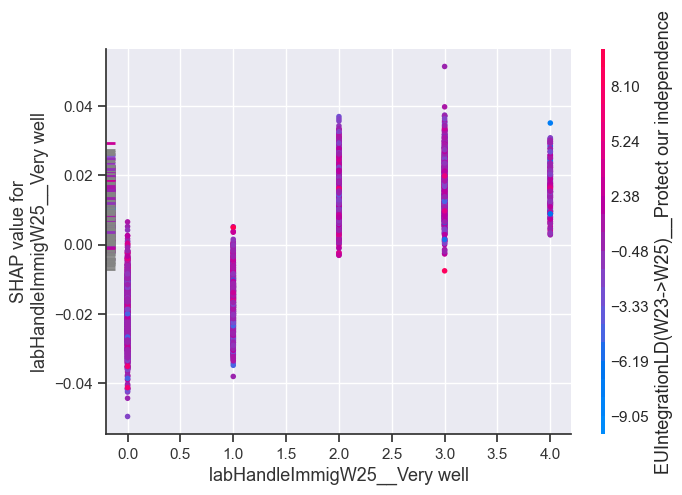

<Figure size 1600x1000 with 0 Axes>

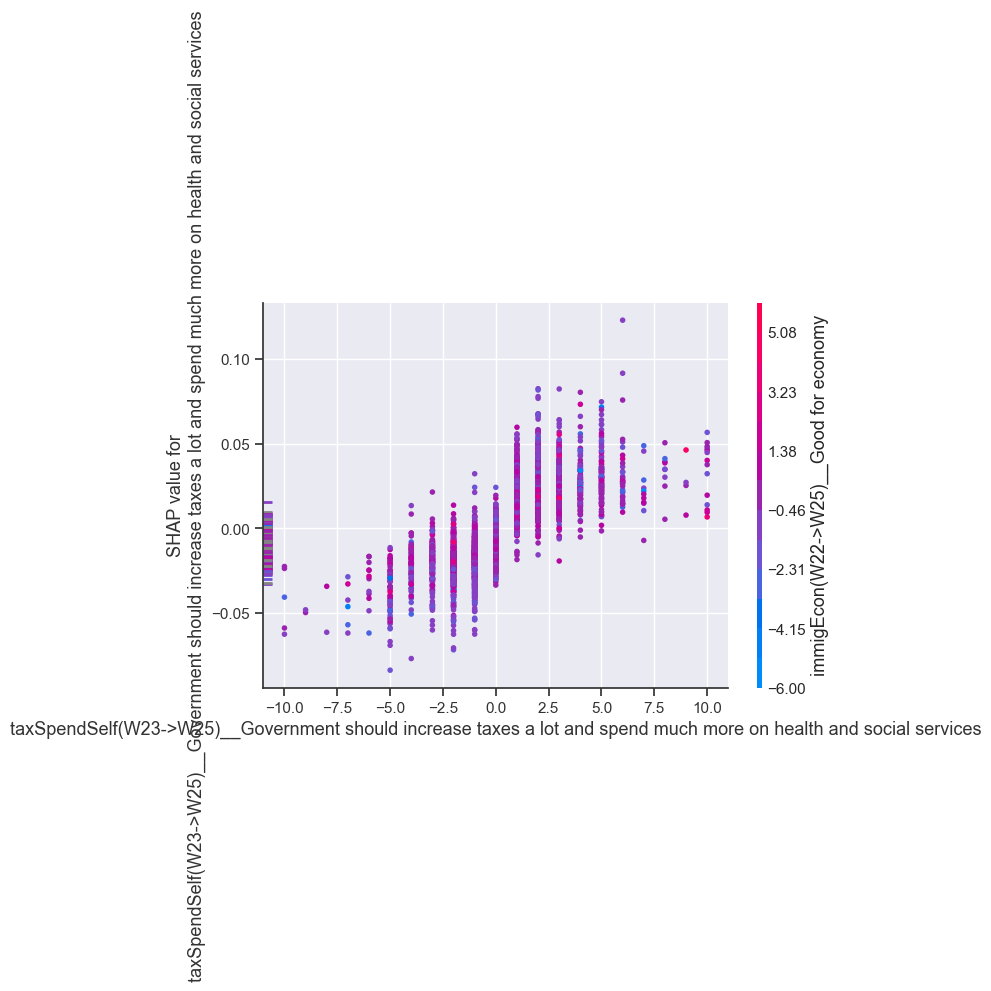

<Figure size 1600x1000 with 0 Axes>

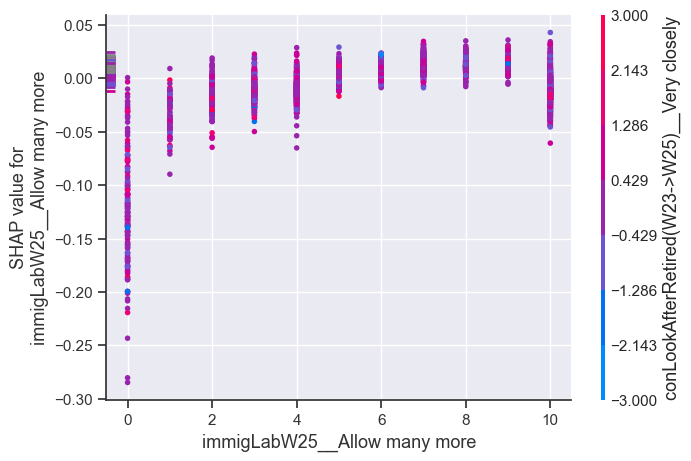

<Figure size 1600x1000 with 0 Axes>

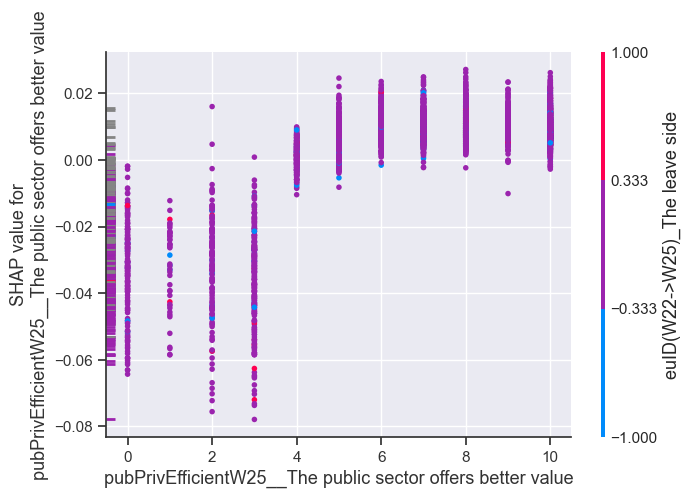

KeyboardInterrupt: 

<Figure size 1600x1000 with 0 Axes>

In [97]:


%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

# mask = BES_Panel["generalElectionVoteW25"]=="I would/did not vote"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,dependence_plots=True,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##
# plot_validation?

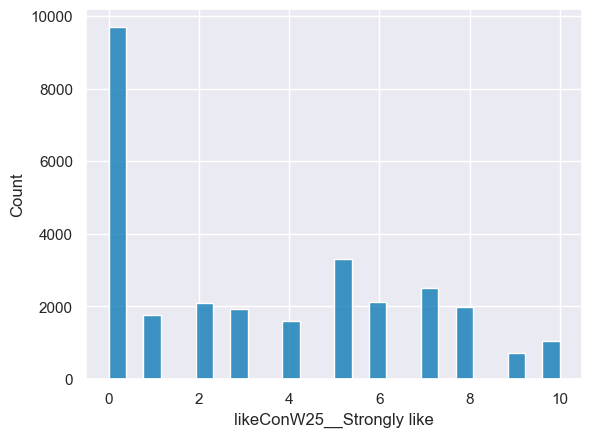

In [121]:
sns.histplot(BES_reduced_with_na["likeConW25__Strongly like"]);

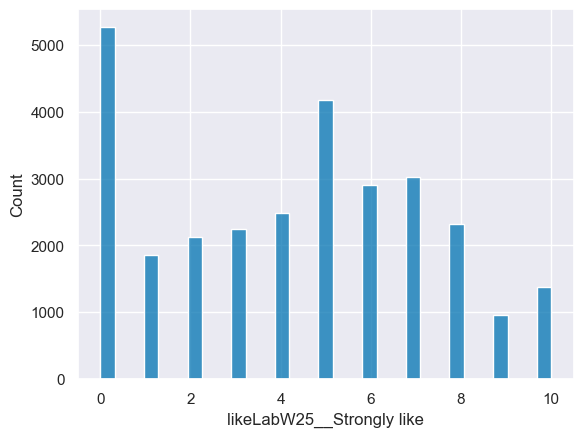

In [122]:
sns.histplot(BES_reduced_with_na["likeLabW25__Strongly like"]);

7883


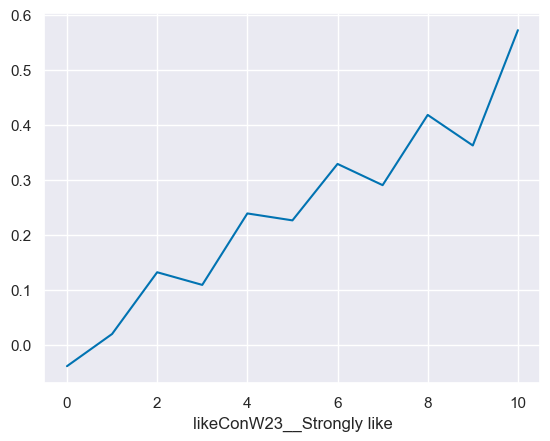

In [118]:
mask = BES_reduced_with_na["likeConW23__Strongly like"].notnull()\
    &BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].notnull()\
    &BES_reduced_with_na["immigCon(W23->W25)__Allow many more"].notnull()
print(mask.sum())

sns.lineplot(BES_reduced_with_na[mask].groupby("likeConW23__Strongly like")\
    .apply(lambda x: x["immigSelf(W23->W25)__Allow many more"].corr(x["immigCon(W23->W25)__Allow many more"])));

7881


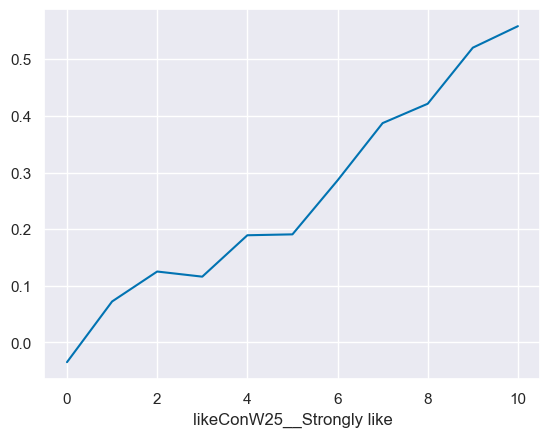

In [119]:
mask = BES_reduced_with_na["likeConW25__Strongly like"].notnull()\
    &BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].notnull()\
    &BES_reduced_with_na["immigCon(W23->W25)__Allow many more"].notnull()
print(mask.sum())

sns.lineplot(BES_reduced_with_na[mask].groupby("likeConW25__Strongly like")\
    .apply(lambda x: x["immigSelf(W23->W25)__Allow many more"].corr(x["immigCon(W23->W25)__Allow many more"])));

7872


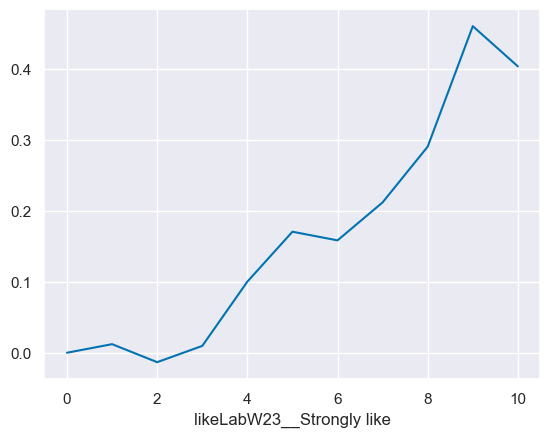

In [124]:
mask = BES_reduced_with_na["likeLabW23__Strongly like"].notnull()\
    &BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].notnull()\
    &BES_reduced_with_na["immigCon(W23->W25)__Allow many more"].notnull()
print(mask.sum())

sns.lineplot(BES_reduced_with_na[mask].groupby("likeLabW23__Strongly like")\
    .apply(lambda x: x["immigSelf(W23->W25)__Allow many more"].corr(x["immigLab(W23->W25)__Allow many more"])));

17312
MSE: 1.48, MAE: 1.03, EV: 0.15, R2: 0.15


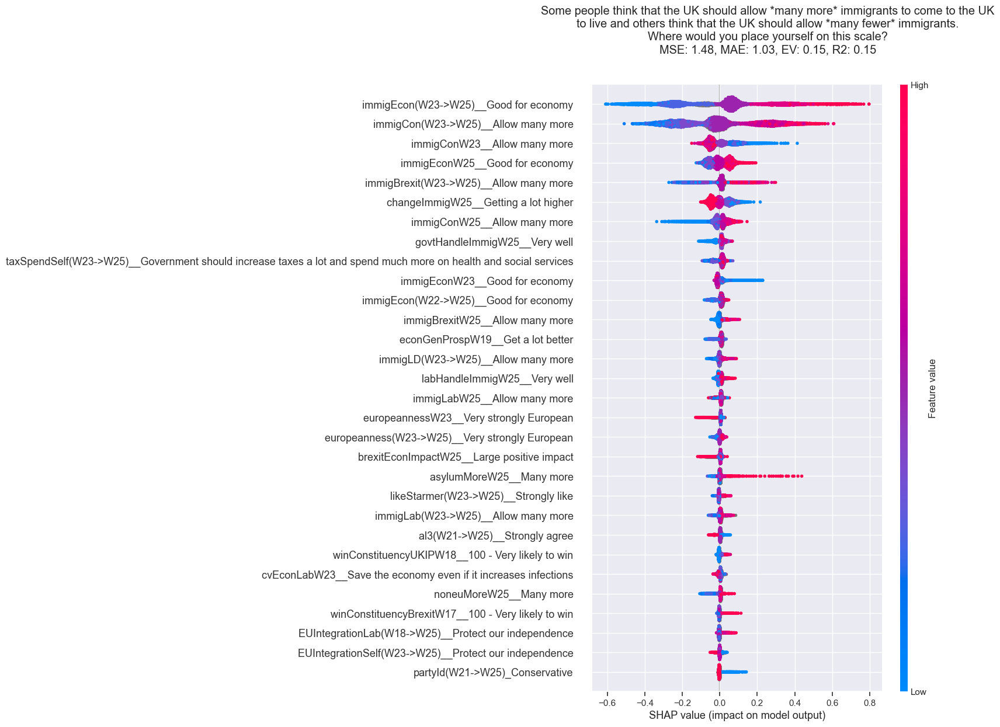

Wall time: 1min 19s


In [126]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["likeConW25__Strongly like"]>1
print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

28790
MSE: 1.47, MAE: 1.04, EV: 0.17, R2: 0.17


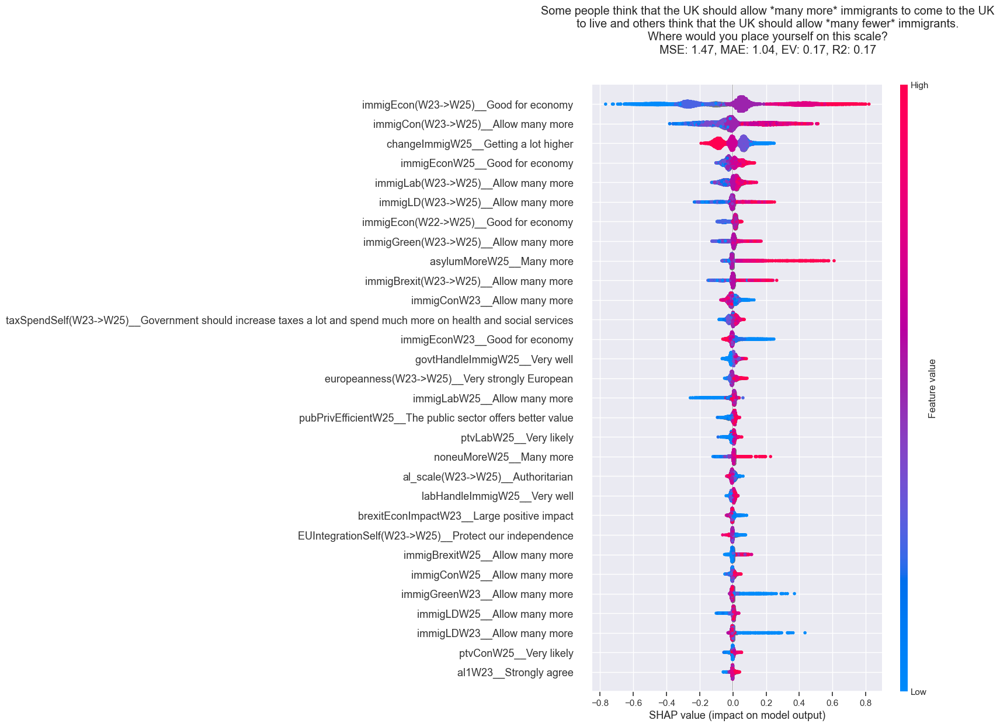

Wall time: 1min 31s


In [127]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["likeConW25__Strongly like"]>=0
print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

8390
MSE: 1.38, MAE: 0.99, EV: 0.18, R2: 0.18


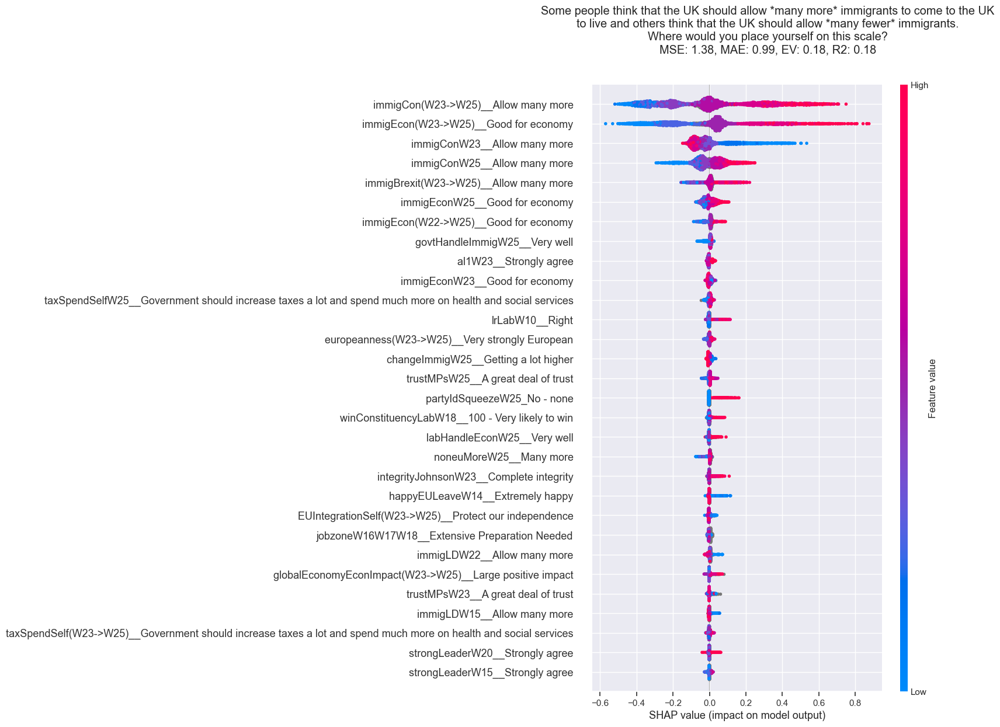

Wall time: 31.4 s


In [128]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["likeConW25__Strongly like"]>5
print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [133]:
BES_reduced_with_na["immigSelf&Econ(W23->W25)__More&Good"] = (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]+BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"])/2

MSE: 0.93, MAE: 0.77, EV: 0.10, R2: 0.10


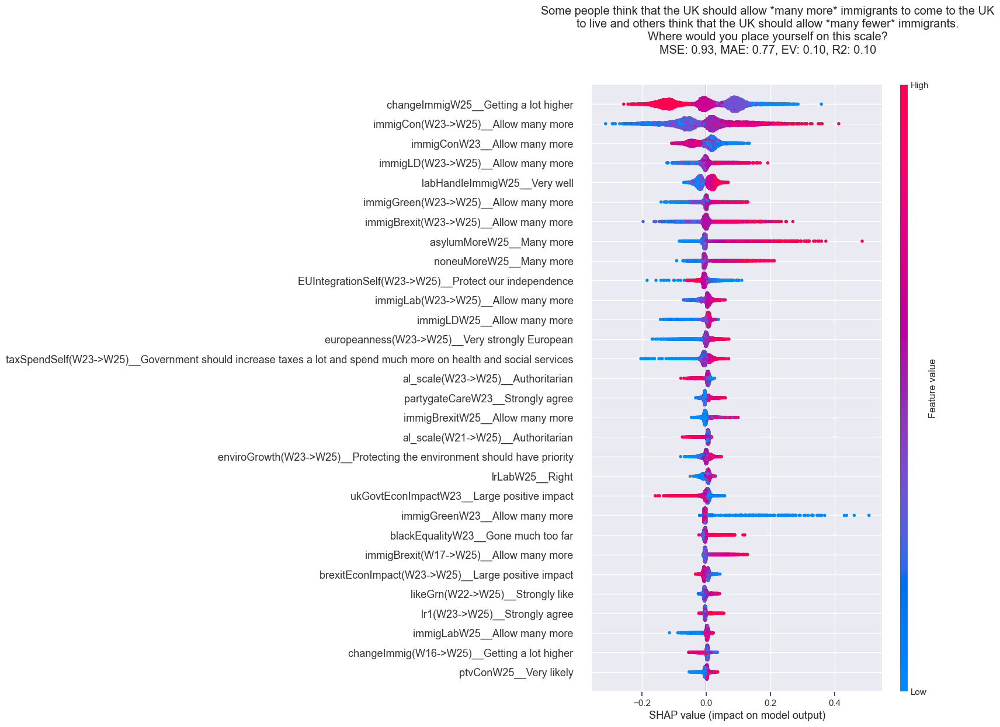

Wall time: 2min 39s


In [134]:
%%time
# 
name="immigSelf&Econ(W23->W25)__More&Good"
stub_list = [name,"immigSelf","immigEcon"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.58, MAE: 1.10, EV: 0.11, R2: 0.11


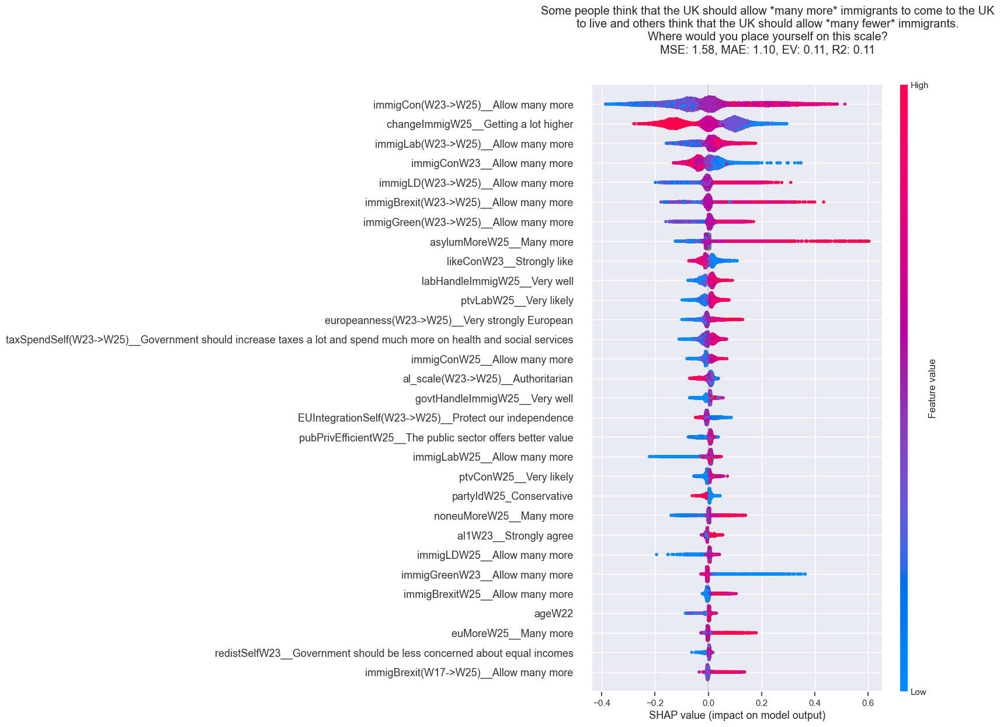

Wall time: 1min 40s


In [135]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [136]:
econ_temp = BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"].copy()

In [137]:
BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"] = econ_temp

BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"] = BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"]\
    .apply( lambda x: x/(np.abs(x)**.5))
BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"].value_counts()

-1.000000    3667
 1.000000    2583
-1.414214    1107
 1.414214     641
-1.732051     308
 1.732051     211
-2.000000      97
 2.000000      30
-2.236068      22
-2.449490      13
 2.449490      12
 2.236068       9
Name: immigEcon(W23->W25)__Good for economy, dtype: int64

In [138]:
BES_reduced_with_na["immigSelf&Econ(W23->W25)__More&Good"] = (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"]+BES_reduced_with_na["immigEcon(W23->W25)__Good for economy"])/2

MSE: 0.99, MAE: 0.84, EV: 0.11, R2: 0.11


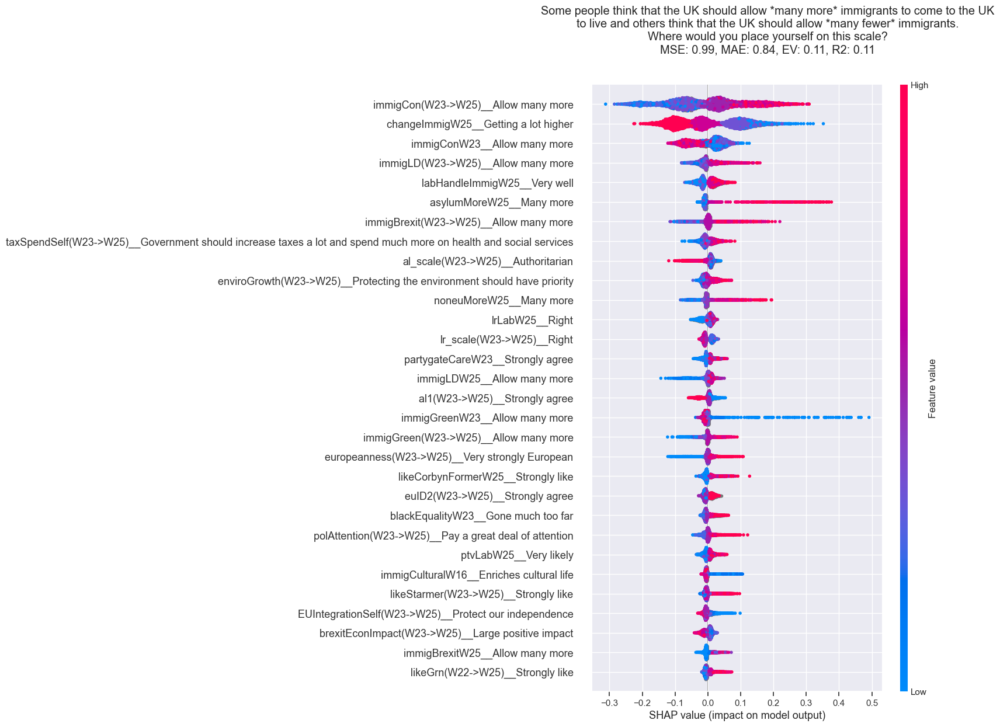

Wall time: 1min 24s


In [139]:
%%time
# 
name="immigSelf&Econ(W23->W25)__More&Good"
stub_list = [name,"immigSelf","immigEcon"]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [141]:
BES_reduced_with_na["immigSelfW23__Allow many more"].value_counts().sort_index()

0.0     5782
1.0     1197
2.0     1833
3.0     2393
4.0     1875
5.0     5337
6.0     2487
7.0     3176
8.0     1965
9.0      504
10.0    1746
Name: immigSelfW23__Allow many more, dtype: int64

MSE: 0.25, MAE: 0.39, EV: 0.14, R2: 0.14


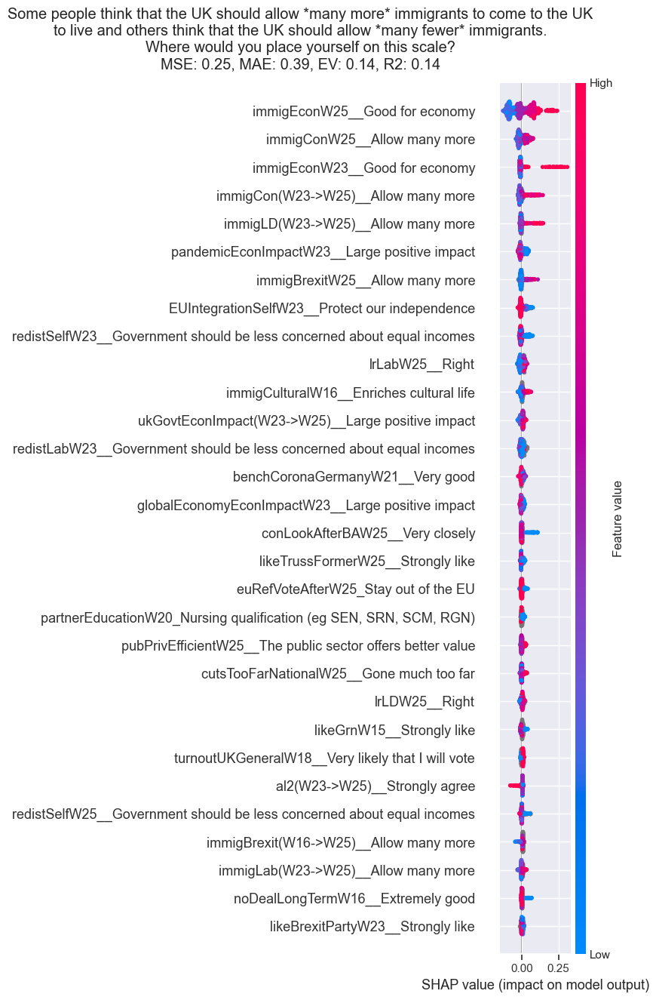

Wall time: 44 s


In [142]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] == 0

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.22, MAE: 0.90, EV: 0.33, R2: 0.33


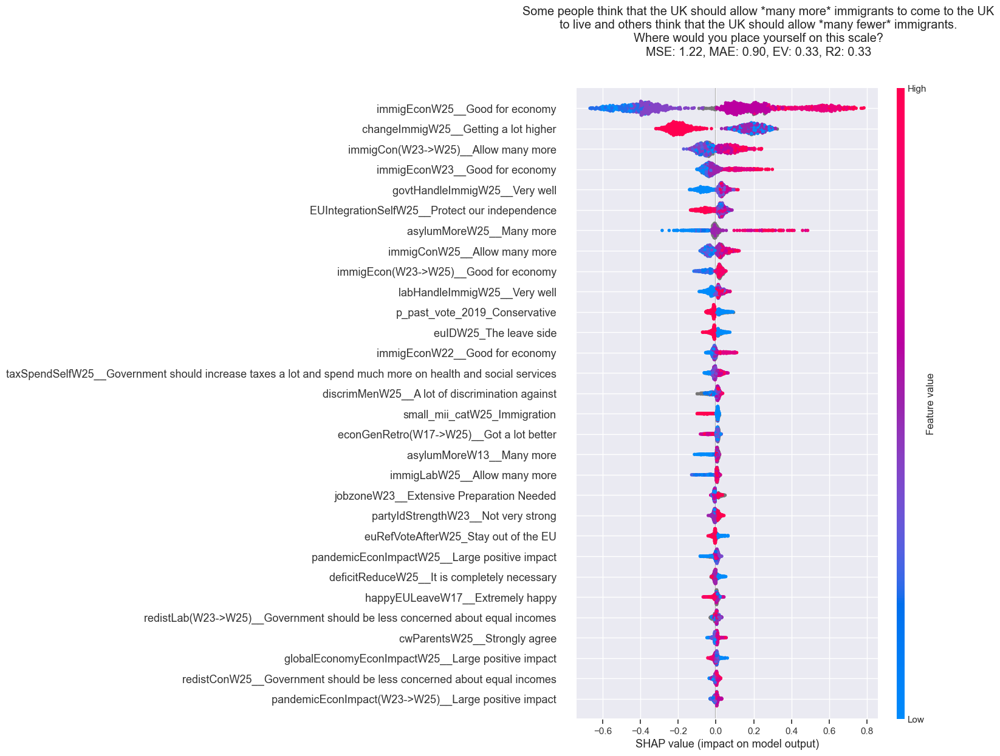

Wall time: 33.3 s


In [148]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] == 3

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 0.94, MAE: 0.77, EV: 0.51, R2: 0.51


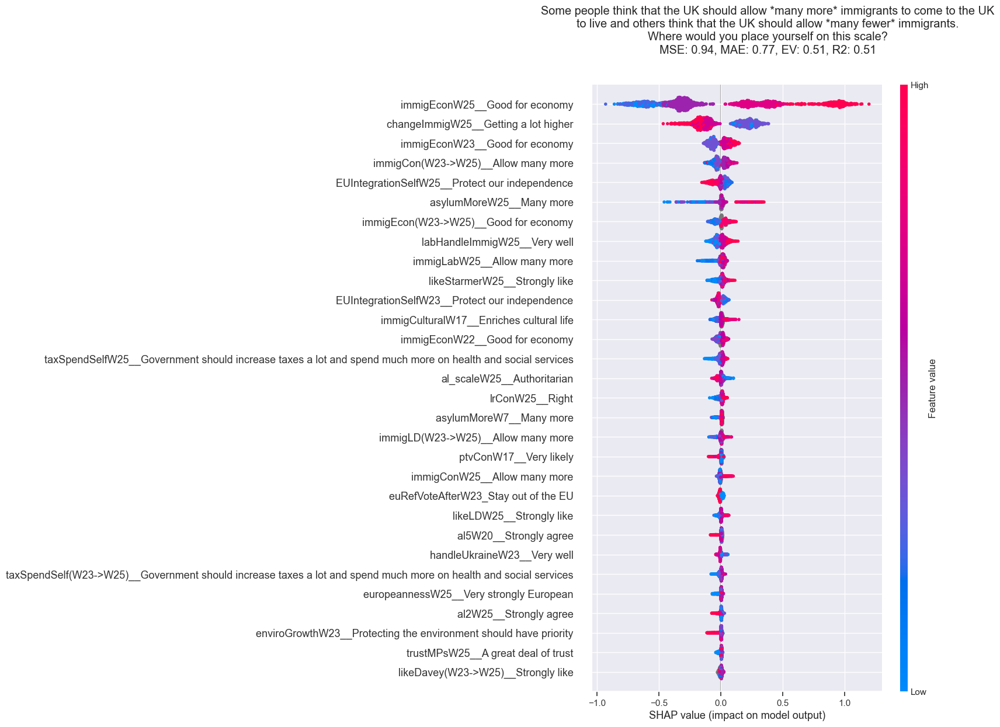

Wall time: 48.2 s


In [143]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] == 5

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 0.85, MAE: 0.72, EV: 0.34, R2: 0.34


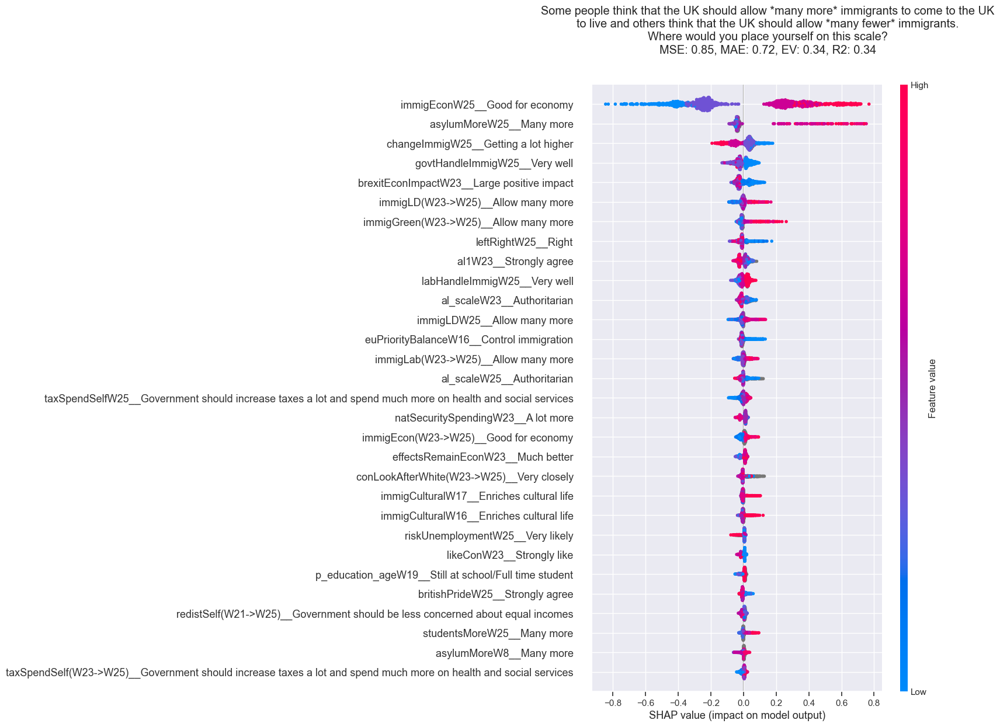

Wall time: 28.4 s


In [149]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] == 7

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 0.77, MAE: 0.67, EV: 0.37, R2: 0.37


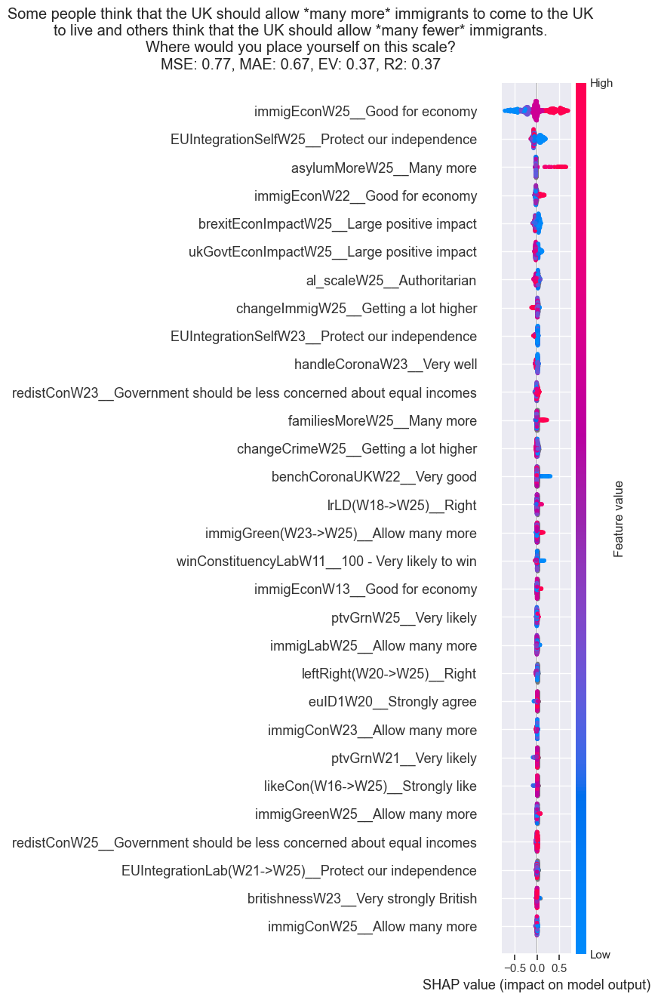

Wall time: 19.3 s


In [150]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] ==8

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 0.58, MAE: 0.55, EV: 0.21, R2: 0.20


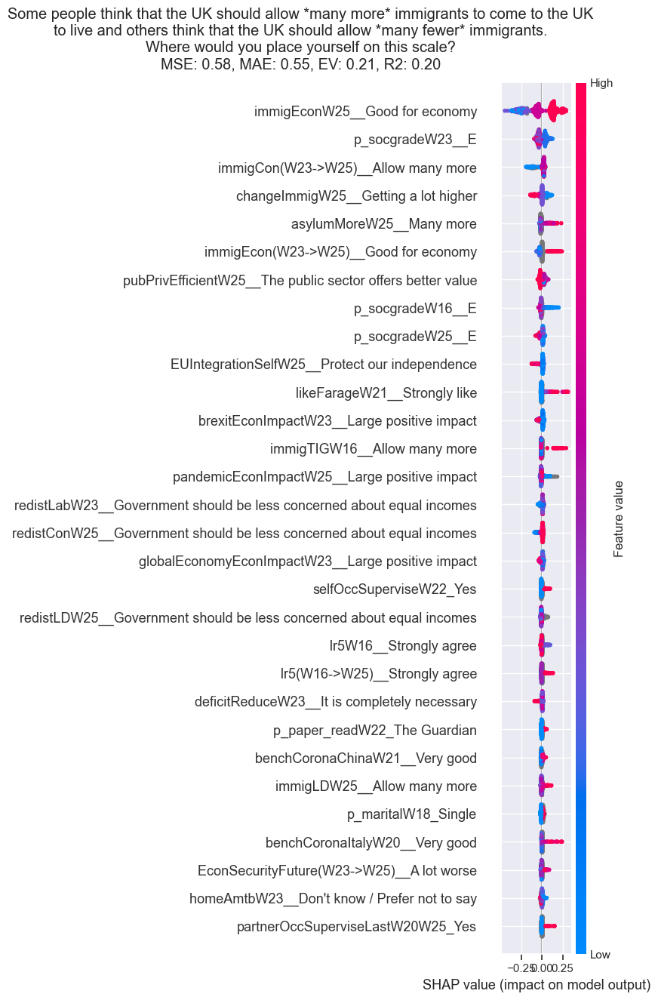

Wall time: 1min 1s


In [146]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] >= 9

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.19, MAE: 0.89, EV: 0.38, R2: 0.38


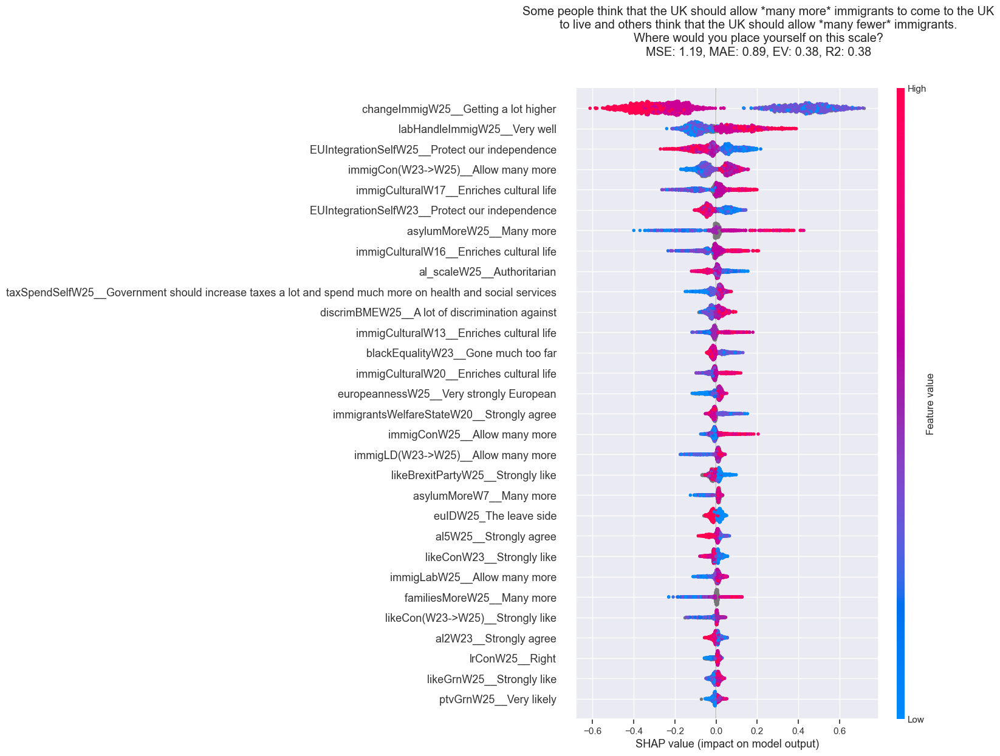

Wall time: 46.8 s


In [152]:
%%time
# 
name="immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelf","immigEcon"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"] ==5

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [ ]:
#########################


# try to find a way to incorporate baseline into the diff variable

# how about positioning 'shifts' by their quantile?

In [192]:
BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].value_counts().sort_index()

-3.162278      17
-3.000000       4
-2.828427      17
-2.645751      37
-2.449490      54
-2.236068     319
-2.000000     318
-1.732051     984
-1.414214    1922
-1.000000    2863
 1.000000    1744
 1.414214     918
 1.732051     356
 2.000000     107
 2.236068     107
 2.449490      33
 2.645751      19
 2.828427       5
 3.000000       4
 3.162278      14
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

In [156]:
immig_temp.value_counts().sort_index()

-10.0      17
-9.0        4
-8.0       17
-7.0       37
-6.0       54
-5.0      319
-4.0      318
-3.0      984
-2.0     1922
-1.0     2863
 0.0     7338
 1.0     1744
 2.0      918
 3.0      356
 4.0      107
 5.0      107
 6.0       33
 7.0       19
 8.0        5
 9.0        4
 10.0      14
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

In [176]:
immig_temp[BES_reduced_with_na["immigSelfW23__Allow many more"]==0].value_counts().sort_index()

0.0     3164
1.0      214
2.0      168
3.0       99
4.0       26
5.0       56
6.0       14
7.0       11
8.0        4
9.0        3
10.0      14
Name: immigSelf(W23->W25)__Allow many more, dtype: int64

In [178]:
(immig_temp[BES_reduced_with_na["immigSelfW23__Allow many more"]==0].dropna().rank()\
    /immig_temp[BES_reduced_with_na["immigSelfW23__Allow many more"]==0].notnull().sum()).describe()

count    3773.000000
mean        0.500133
std         0.184863
min         0.419428
25%         0.419428
50%         0.419428
75%         0.419428
max         0.998277
Name: immigSelf(W23->W25)__Allow many more, dtype: float64

In [160]:
immig_temp.index = BES_Panel.index

In [195]:
immig_temp = BES_reduced_with_na["immigSelfW25__Allow many more"] - BES_reduced_with_na["immigSelfW23__Allow many more"]

In [179]:
baseline = BES_reduced_with_na["immigSelfW23__Allow many more"]

In [183]:
def standardize(x):
    return (x-np.min(x))/(np.max(x)-np.min(x))

In [200]:
((immig_temp-np.min(immig_temp))/(np.max(immig_temp)-np.min(immig_temp))).describe()

count    17180.000000
mean         0.478775
std          0.088165
min          0.000000
25%          0.450000
50%          0.500000
75%          0.500000
max          1.000000
dtype: float64

In [210]:
immig_temp.groupby(baseline).apply(standardize).sort_index()

count    17180.000000
mean         0.366391
std          0.301965
min          0.000000
25%          0.000000
50%          0.400000
75%          0.600000
max          1.000000
dtype: float64

In [211]:
BES_reduced_with_na["immigSelfTestTarget"] = np.nan
BES_reduced_with_na["immigSelfTestTarget"] = immig_temp.groupby(baseline).apply(standardize)

MSE: 0.02, MAE: 0.12, EV: 0.74, R2: 0.74


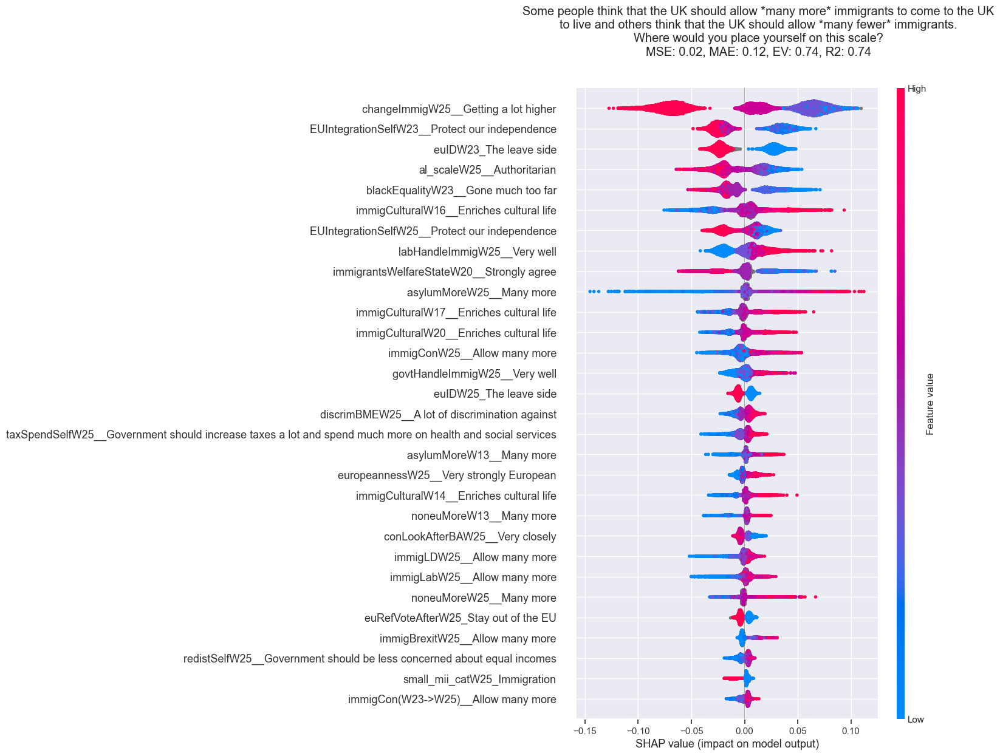

Wall time: 10min 10s


In [216]:
%%time
# 
name="immigSelfTestTarget"
stub_list = [name,"immigSelf","immigEcon"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"] ==5

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 0.02, MAE: 0.10, EV: 0.78, R2: 0.78


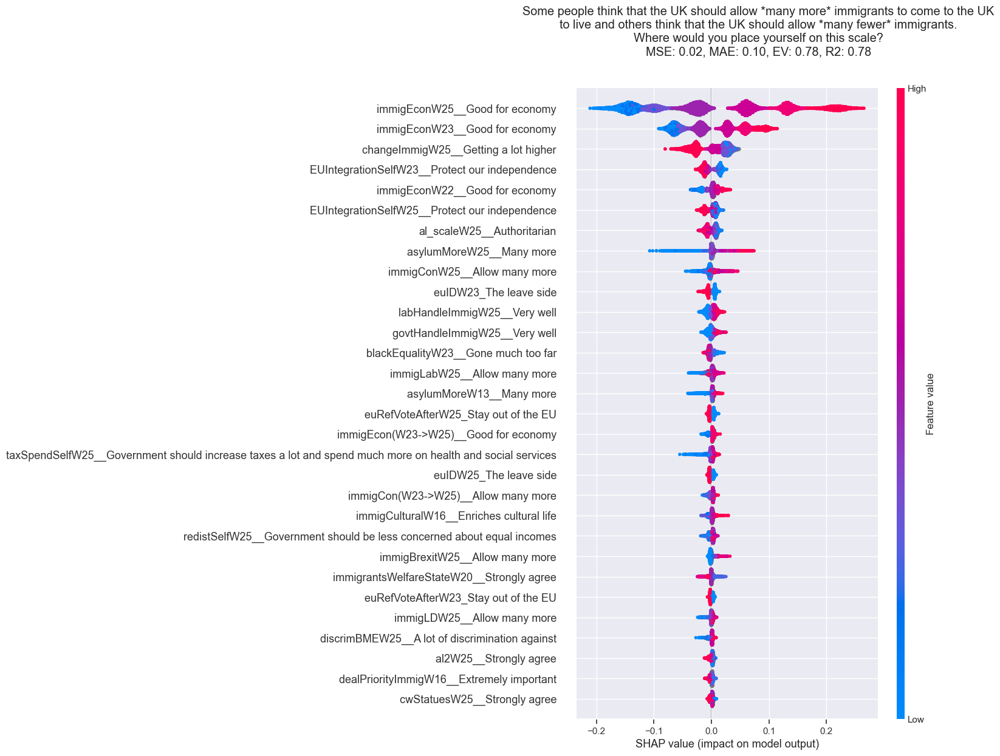

Wall time: 6min 49s


In [217]:
%%time
# 
name="immigSelfTestTarget"
stub_list = [name,"immigSelf"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"] ==5

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [ ]:
## Have we reduced or increased the noise/dependence on the baseline here?

# do we need a 'noise model' comparison

MSE: 0.02, MAE: 0.10, EV: 0.78, R2: 0.78


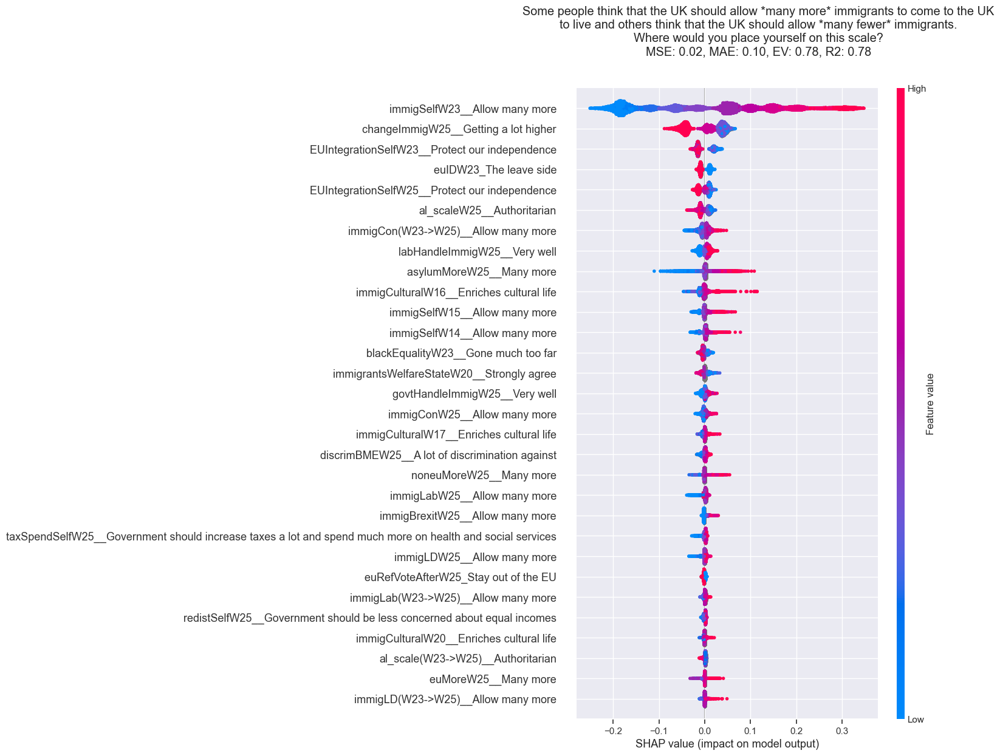

Wall time: 4min 55s


In [219]:
%%time
# 
name="immigSelfTestTarget"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"] ==5

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [ ]:
##### okay - let's have a look at the transition matrix across *all* waves (adjacent) waves

In [220]:
search(BES_reduced_with_na,"immigSelf")

# 7,8,9,10,11,12, 14,15,16,17,  20,21,22,23, 25

# list every transaction in two columns
# pd.crosstab -> transition matrix#

# wait, do want a raw count? do we want to use weights per wave and average over waves?
# three/four columns weight wave/weights!

immigSelfW7__Allow many more            26966
immigSelfW8__Allow many more            30249
immigSelfW9__Allow many more            28146
immigSelfW10__Allow many more           26967
immigSelfW11__Allow many more           27908
immigSelfW12__Allow many more            8259
immigSelfW14__Allow many more           28138
immigSelfW15__Allow many more           27678
immigSelfW16__Allow many more           33922
immigSelfW17__Allow many more           30535
immigSelfW20__Allow many more           28510
immigSelfW21__Allow many more           27397
immigSelfW22__Allow many more           25277
immigSelfW23__Allow many more           28295
immigSelfW25__Allow many more           27826
immigSelf(W16->W25)__Allow many more    13099
immigSelf(W17->W25)__Allow many more    12864
immigSelf(W20->W25)__Allow many more    12263
immigSelf(W21->W25)__Allow many more    13762
immigSelf(W22->W25)__Allow many more    14643
immigSelf(W23->W25)__Allow many more     9842
immigSelf&Econ(W23->W25)__More&Goo

In [224]:
wave_list = [ 7,8,9,10,11,12, 14,15,16,17,  20,21,22,23, 25 ]
df = pd.DataFrame(columns = ["source","destination","source_wave","destination_wave","source_weight","destination_weight"])

for source_wave in wave_list[:-1]:
    


[7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 20, 21, 22, 23]

In [267]:
wave_list = [ 7,8,9,10,
#              11,
#              12,
             14,15,16,17,  20,21,22,23, 25 ]
df = pd.DataFrame(columns = ["source","destination","source_wave","destination_wave","source_weight","destination_weight"])

for pos in range(len(wave_list)-1):

    temp_df = BES_reduced_with_na[["immigSelfW"+str(wave_list[pos])+"__Allow many more",
                                   "immigSelfW"+str(wave_list[pos+1])+"__Allow many more"]]
    temp_df.columns = ["source","destination"]
    temp_df["source_wave"] = wave_list[pos]
    temp_df["destination_wave"] = wave_list[pos+1]
    temp_df["source_weight"] = BES_Panel["wt_new_W"+str(wave_list[pos])]
    temp_df["destination_weight"] = BES_Panel["wt_new_W"+str(wave_list[pos+1])]
    temp_df = temp_df[temp_df.notnull().all(axis=1)]

    # should re-add/use DKs?
    df = df.append(temp_df)
    
    
    # drop wave 11 - no overlap!, wave 12 very little overlap
    
df["diff"] = df["destination"] - df["source"]

In [264]:
df["source_wave"].value_counts().sort_index()

7     20527
8     24266
9     17022
10    15278
14    17166
15    16816
16    18618
17    15461
20    14165
21    16490
22    17549
23    17180
Name: source_wave, dtype: int64

In [265]:
df

,source,destination,source_wave,destination_wave,source_weight,destination_weight
1,0.0,0.0,7,8,1.407584,1.462051
2,3.0,4.0,7,8,1.193967,0.356974
7,0.0,0.0,7,8,0.611095,0.618348
9,2.0,3.0,7,8,0.611876,0.267952
11,2.0,4.0,7,8,1.194464,1.153234
...,...,...,...,...,...,...
109122,8.0,7.0,23,25,1.043033,1.382145
109152,5.0,6.0,23,25,1.378349,1.118441
109157,8.0,7.0,23,25,0.980570,0.594701
109170,4.0,5.0,23,25,1.918826,0.827737


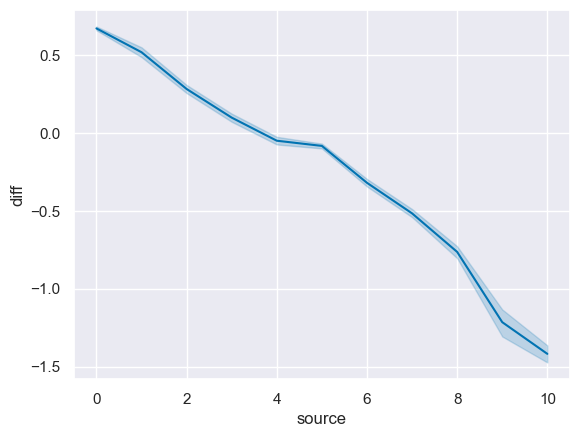

In [268]:
sns.lineplot(data=df,x="source",y="diff");

<AxesSubplot:xlabel='source', ylabel='Count'>

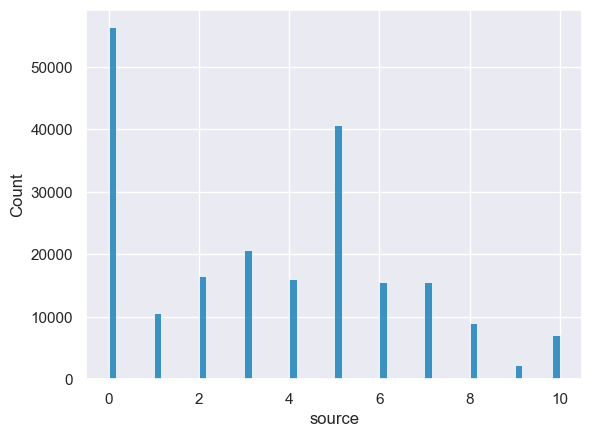

In [270]:
sns.histplot(data=df,x="source")

In [ ]:
## cur problem into two portions? 0-1, 2-7, 8-10

## 5 is also a problem!


# tempting to break it 0-1, 2-4, 5, 6-8, 9-10

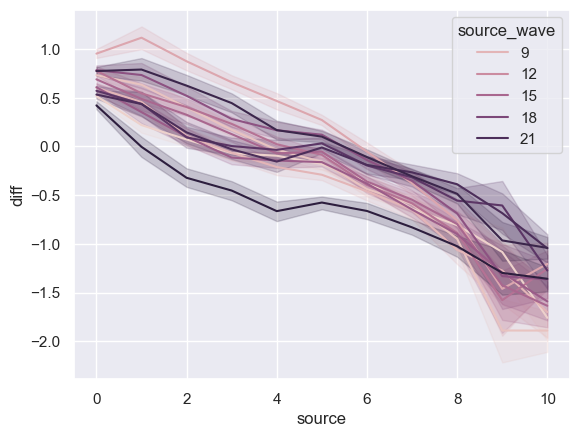

In [269]:
sns.lineplot(data=df,x="source",y="diff",hue="source_wave");

In [248]:
pd.crosstab(df["source"],df["destination"])

destination,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
source,,,,,,,,,,,
0.0,44297,3939,3833,2542,994,1536,271,178,127,62,214
1.0,3998,2377,2144,1296,447,458,107,58,30,17,24
2.0,3519,2085,4291,3789,1441,1334,304,148,74,23,25
3.0,2353,1209,3537,6175,3537,3252,688,338,120,26,47
4.0,837,441,1299,3289,4149,4803,1131,466,129,24,37
5.0,1381,442,1216,2886,4147,21523,5348,3400,1078,157,426
6.0,254,98,254,593,1014,5119,4162,3174,1035,144,233
7.0,172,62,155,270,421,3112,2999,5141,2608,437,659
8.0,115,34,72,117,128,1023,929,2440,2705,688,1081


In [252]:
pd.crosstab(df["source"],df["destination"],normalize='index',margins=True)

destination,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
source,,,,,,,,,,,
0.0,0.763834,0.067922,0.066094,0.043833,0.017140,0.026486,0.004673,0.003069,0.002190,0.001069,0.003690
1.0,0.364914,0.216959,0.195692,0.118291,0.040800,0.041804,0.009766,0.005294,0.002738,0.001552,0.002191
2.0,0.206599,0.122409,0.251923,0.222451,0.084600,0.078319,0.017848,0.008689,0.004345,0.001350,0.001468
3.0,0.110563,0.056809,0.166197,0.290151,0.166197,0.152805,0.032328,0.015882,0.005639,0.001222,0.002208
4.0,0.050407,0.026558,0.078229,0.198073,0.249864,0.289250,0.068112,0.028064,0.007769,0.001445,0.002228
5.0,0.032878,0.010523,0.028950,0.068708,0.098729,0.512404,0.127321,0.080945,0.025664,0.003738,0.010142
6.0,0.015796,0.006095,0.015796,0.036878,0.063060,0.318346,0.258831,0.197388,0.064366,0.008955,0.014490
7.0,0.010726,0.003866,0.009666,0.016837,0.026253,0.194063,0.187017,0.320591,0.162634,0.027251,0.041095
8.0,0.012323,0.003643,0.007715,0.012538,0.013716,0.109623,0.099550,0.261466,0.289863,0.073725,0.115838


In [ ]:
## 0, 3, 5, 7, 10 - modes

<AxesSubplot:xlabel='diff', ylabel='Count'>

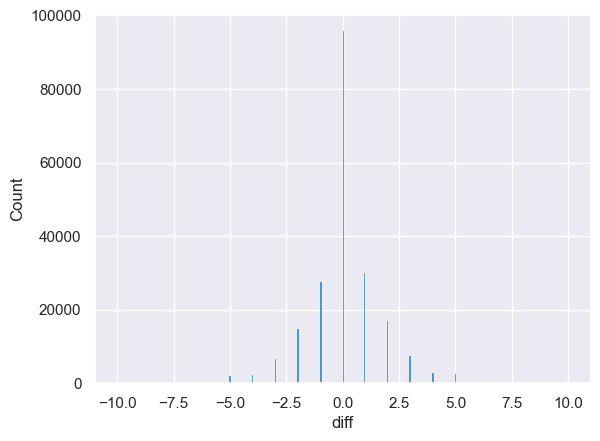

In [271]:
sns.histplot(data=df,x='diff')

In [272]:
df["diff"].mean()

0.05959969221708195

In [ ]:
## try dropping diffs |x| >3
## try source range 2-7

MSE: 0.99, MAE: 0.81, EV: 0.44, R2: 0.44


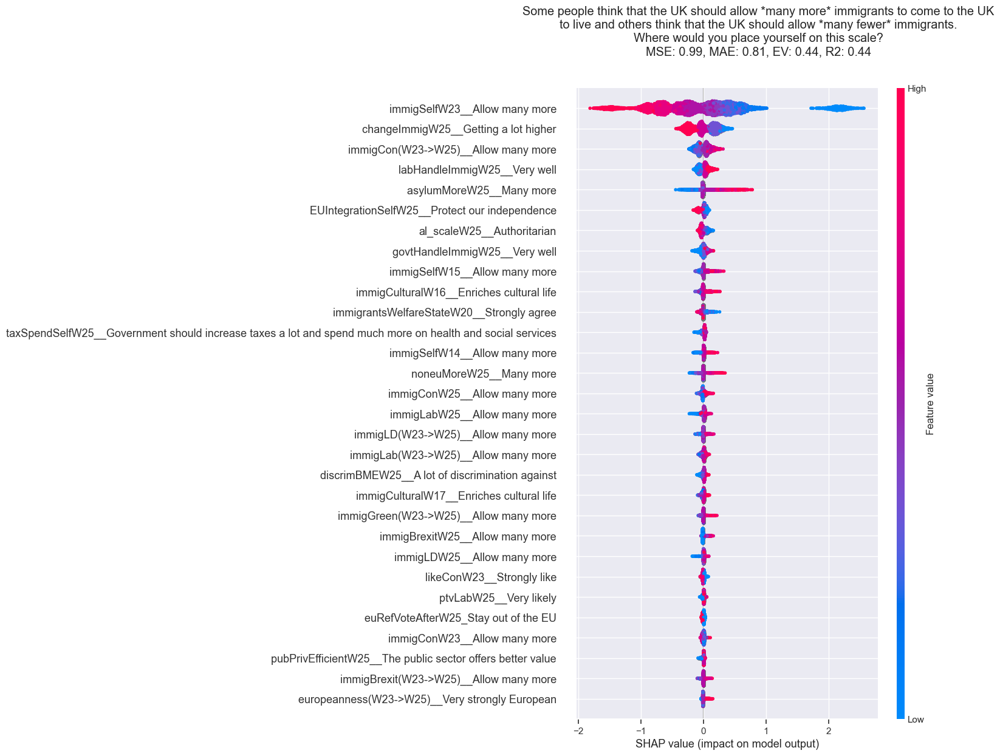

Wall time: 5min 55s


In [275]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

## Control!

MSE: 0.99, MAE: 0.81, EV: 0.43, R2: 0.43


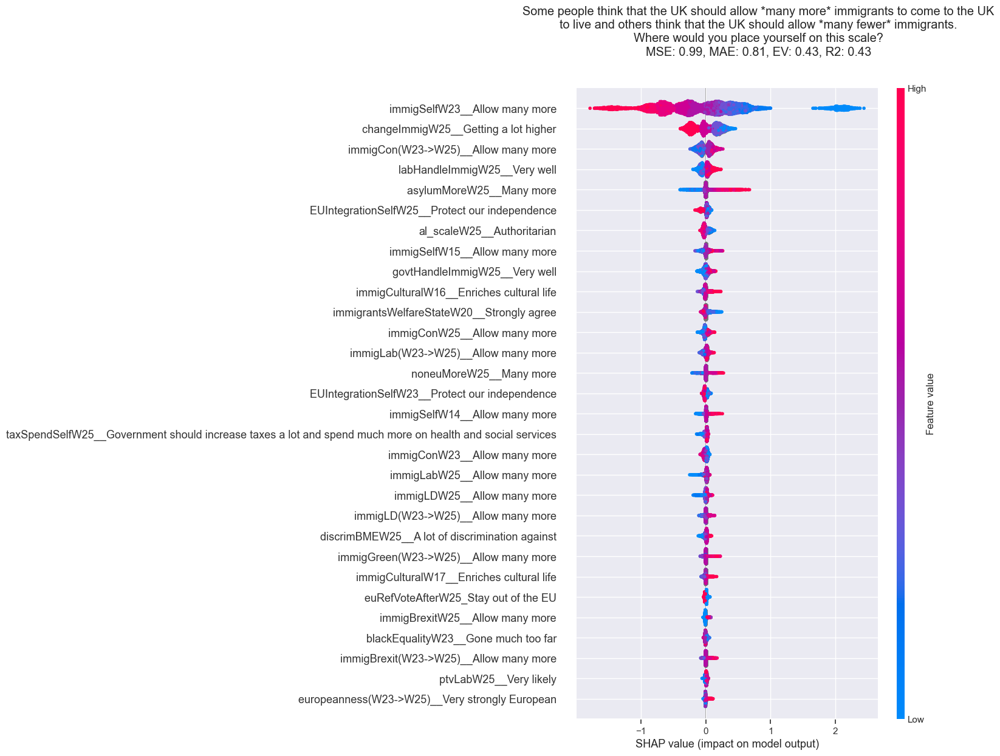

Wall time: 4min 1s


In [276]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.10, MAE: 0.87, EV: 0.33, R2: 0.33


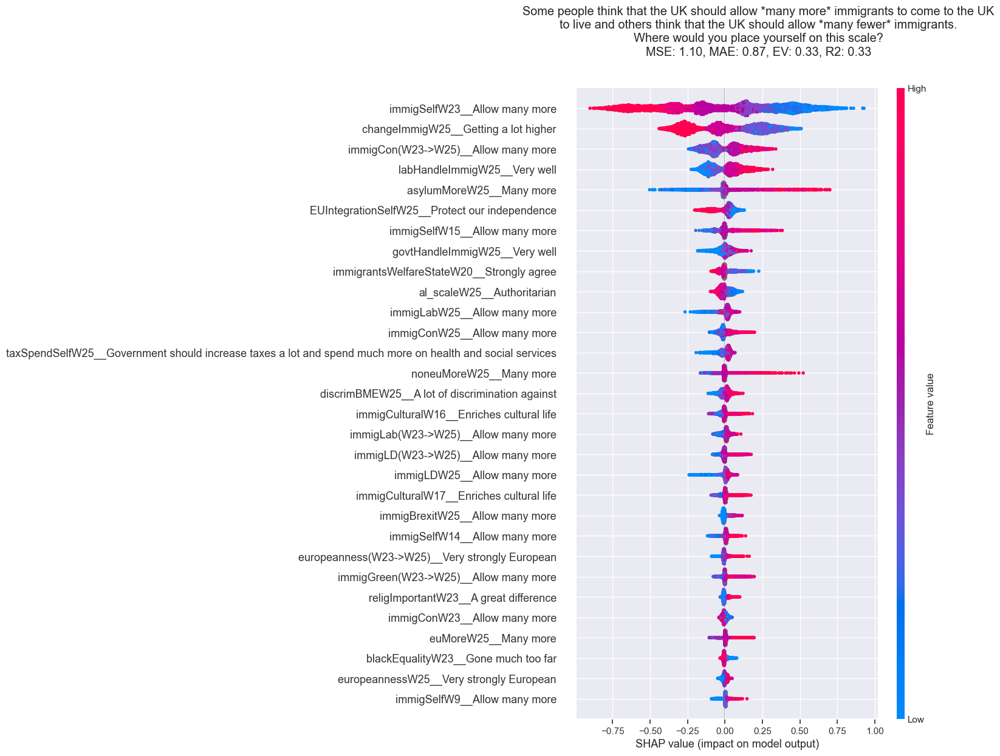

Wall time: 2min 48s


In [277]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = (BES_reduced_with_na["immigSelfW23__Allow many more"]>=2) & (BES_reduced_with_na["immigSelfW23__Allow many more"]<=7)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.12, MAE: 0.89, EV: 0.36, R2: 0.35


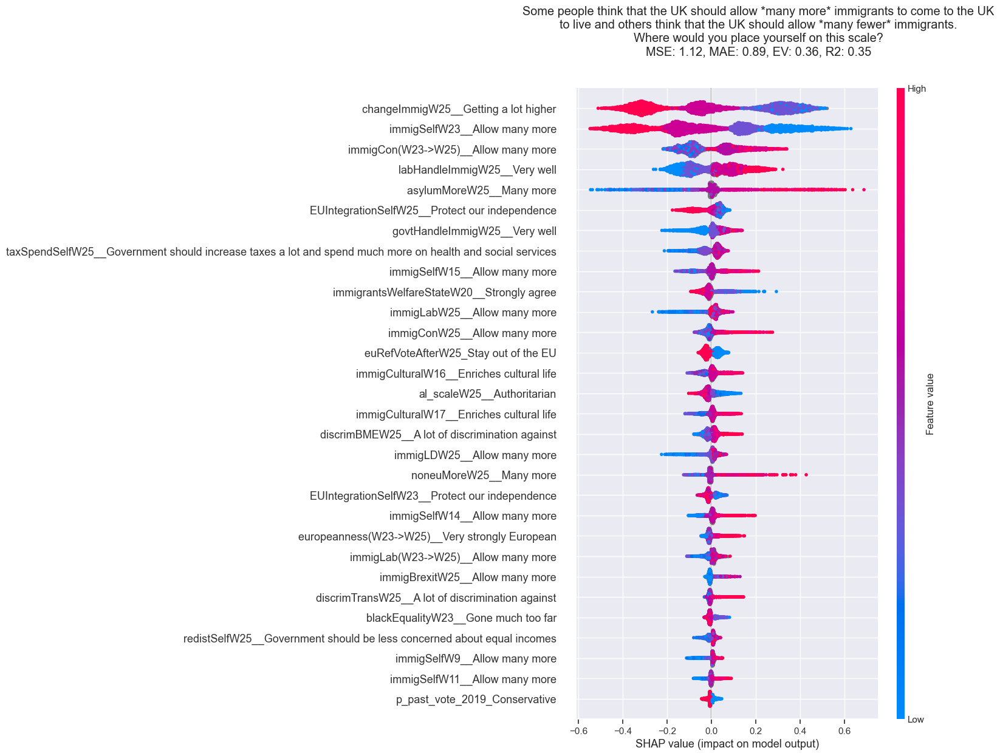

Wall time: 1min 24s


In [278]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = (BES_reduced_with_na["immigSelfW23__Allow many more"]>=3) & (BES_reduced_with_na["immigSelfW23__Allow many more"]<=6)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.28, MAE: 0.97, EV: 0.25, R2: 0.25


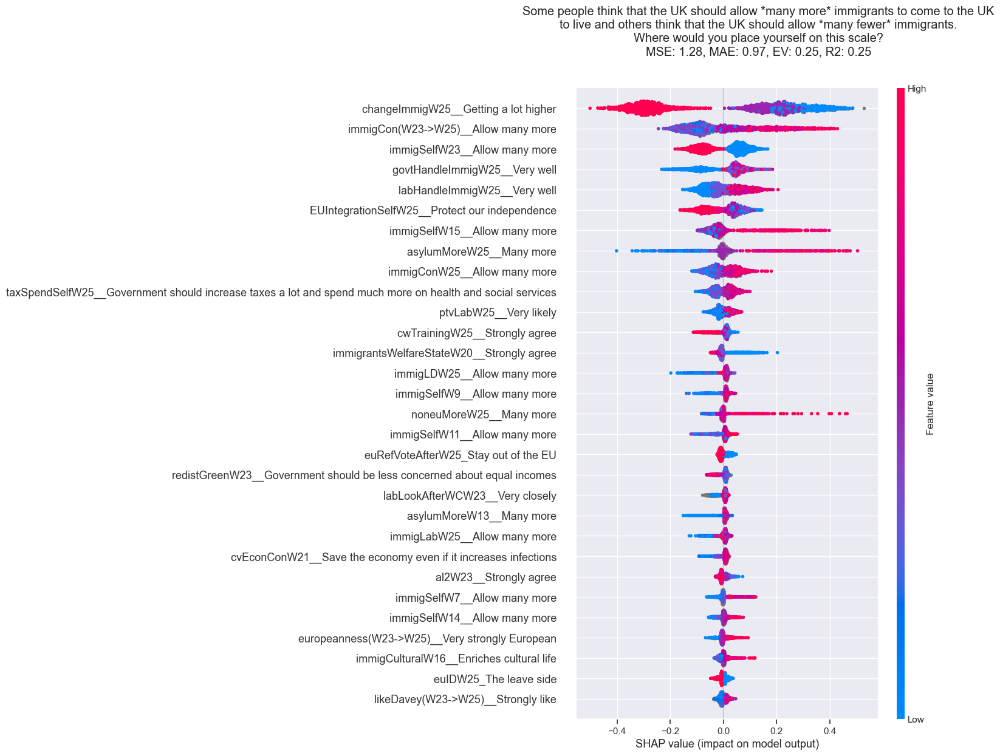

Wall time: 55.3 s


In [280]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.28, MAE: 0.97, EV: 0.25, R2: 0.25


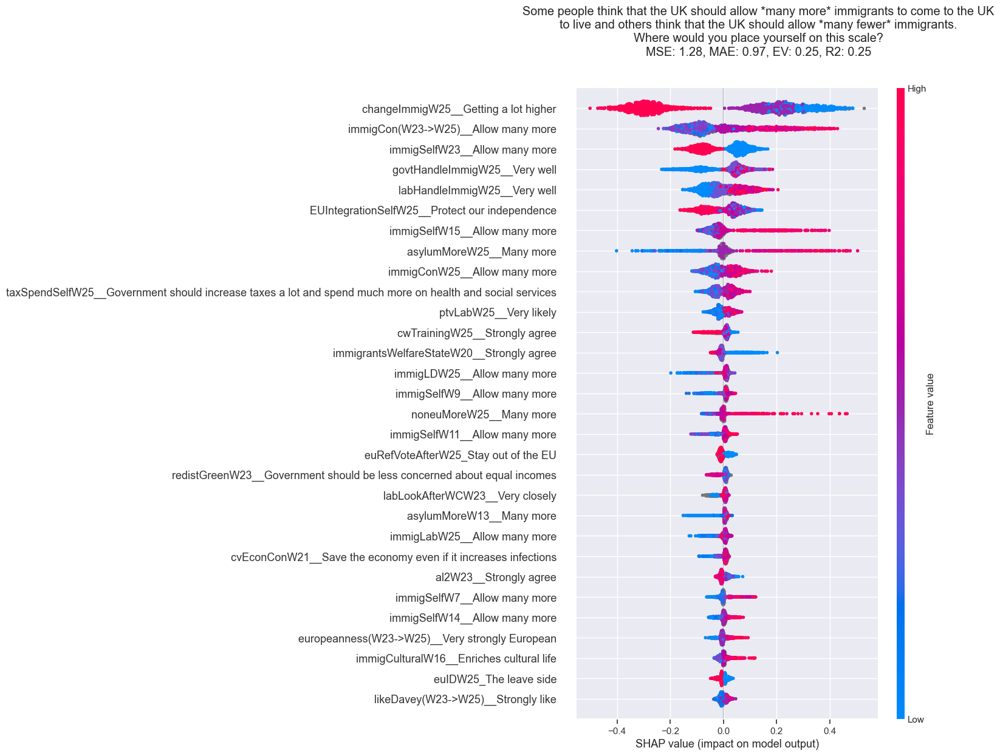

Wall time: 1min


In [281]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)

(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 1.25, MAE: 0.95, EV: 0.22, R2: 0.22


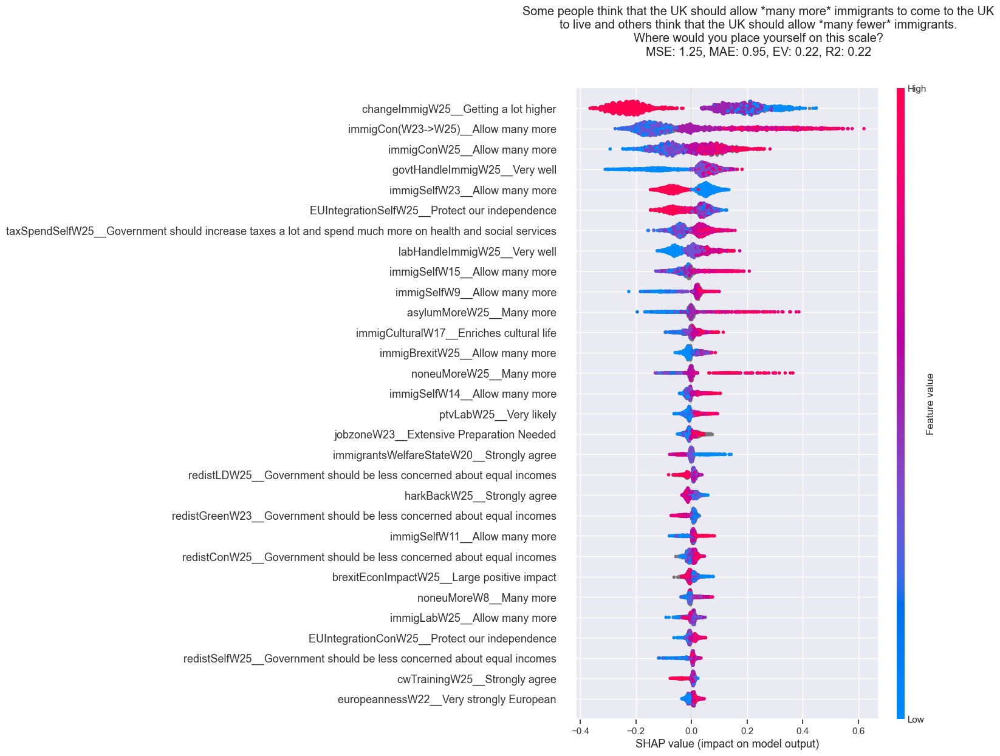

Wall time: 1min 33s


In [290]:
%%time
# 
name= "immigSelf(W23->W25)__Allow many more"
stub_list = [name,"immigSelfW25__Allow many more","immigEcon","immigSelf(W23->W25)__Allow many more",
            "immigSelf(W22->W25)__Allow many more","immigSelf(W21","immigSelf(W20","immigSelf(W17","immigSelf(W16",
             "immigSelfW22",
            "immigSelf&Econ","immigSelfW21","immigSelfW20","immigSelfW17","immigSelfW16",
            "immigSelfTestTarget"]

mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na[mask],
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [288]:
# pd.crosstab(BES_reduced_with_na["immigSelfW23__Allow many more"],BES_reduced_with_na["likeConW25__Strongly like"])

likeConW25__Strongly like,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
immigSelfW23__Allow many more,,,,,,,,,,,
0.0,896,173,190,199,188,529,315,387,406,171,298
1.0,82,33,46,63,60,123,85,99,95,38,43
2.0,153,60,68,79,68,157,167,174,143,46,49
3.0,234,70,94,88,115,225,179,227,185,48,74
4.0,197,62,76,99,93,180,134,156,120,42,37
5.0,1054,234,277,251,190,463,237,311,197,63,84
6.0,528,125,139,136,91,141,101,109,76,22,23
7.0,854,167,190,136,87,120,90,88,70,17,21
8.0,660,100,79,72,38,64,40,35,24,11,16


In [ ]:
## have a think about how to separate balance of

# immigConWX->Y <- mediated by likeConWX -> immigSelfWX->Y

# hyp A immigCon perceived position - and shifts thereof - drives changes in voter position on immigration based on likeCon
# hyp B voter position drives where they place Con based on how much they like them

# (1) What happens if/when likeCon goes up/down?
# (2) What happens with other parties and their partisans?
# (3) What happens with other issues?



MSE: 2.92, MAE: 1.21, EV: 0.45, R2: 0.45


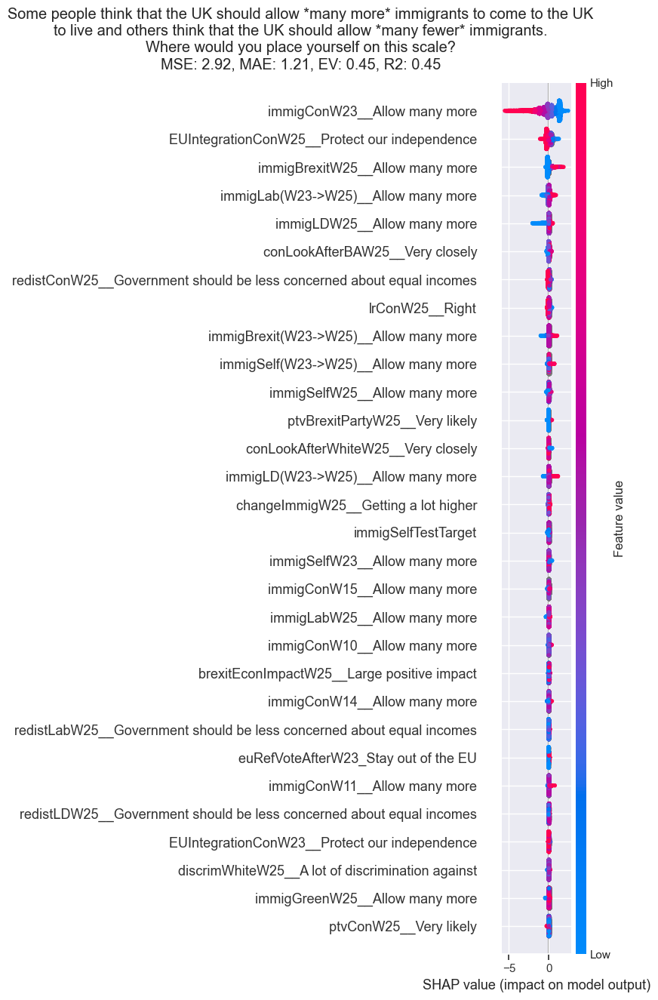

Wall time: 5min 59s


In [295]:
%%time
# 
name= "immigCon(W23->W25)__Allow many more"
stub_list = [name,"immigConW25__Allow many more","immigCon(W23->W25)__Allow many more",
            "immigCon(W22->W25)__Allow many more","immigCon(W21","immigCon(W20","immigCon(W17","immigCon(W16",
             "immigConW22",
#             "immigSelf&Econ",
             "immigConW21","immigConW20","immigConW17","immigConW16",
#             "immigSelfTestTarget"
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 4.21, MAE: 1.51, EV: 0.04, R2: 0.04


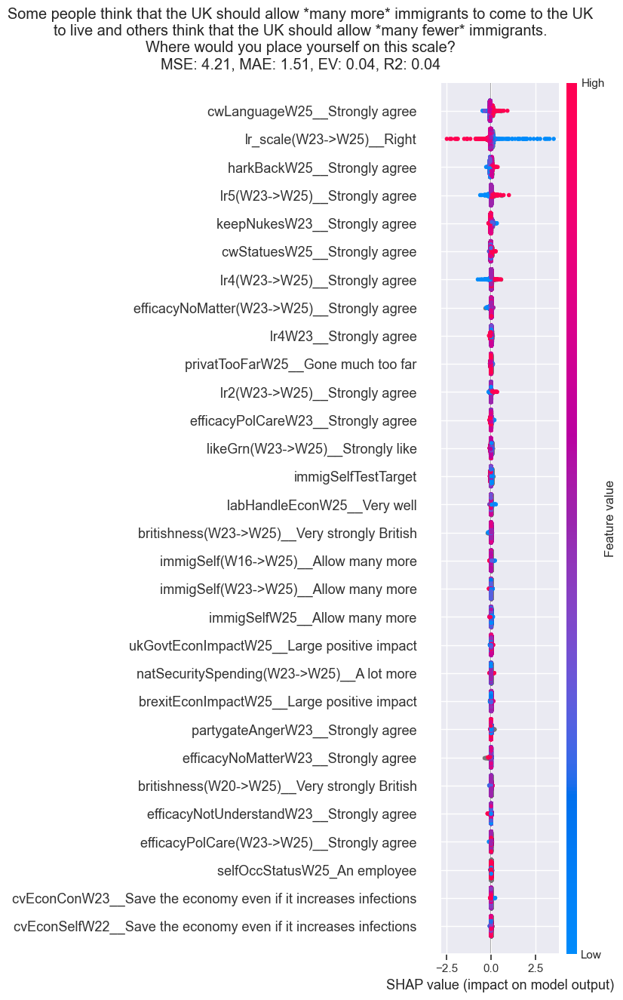

Wall time: 2min 2s


In [303]:
%%time
# 
name= "al_scale(W23->W25)__Authoritarian"
stub_list = [name,"al_scaleW25__Authoritarian",
             "al1","al2","al3","al4","al5",
             "al_scale(","al_scaleW24","al_scaleW23","al_scaleW22","al_scaleW21","al_scaleW20","al_scaleW19",
             "al_scaleW17","al_scaleW16","al_scaleW14",
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 3.52, MAE: 1.41, EV: 0.20, R2: 0.20


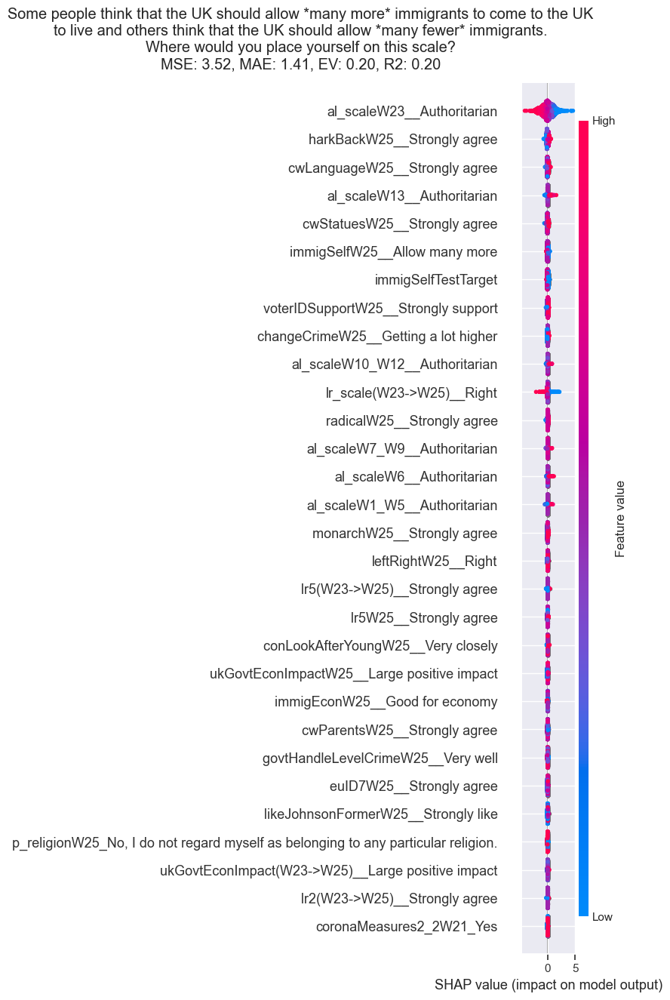

Wall time: 4min 47s


In [307]:
%%time
# 
name= "al_scale(W23->W25)__Authoritarian"
stub_list = [name,"al_scaleW25__Authoritarian",
             "al1","al2","al3","al4","al5",
             "al_scale(","al_scaleW24","al_scaleW22","al_scaleW21","al_scaleW20","al_scaleW19",
             "al_scaleW17","al_scaleW16","al_scaleW14",
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 3.67, MAE: 1.43, EV: 0.16, R2: 0.16


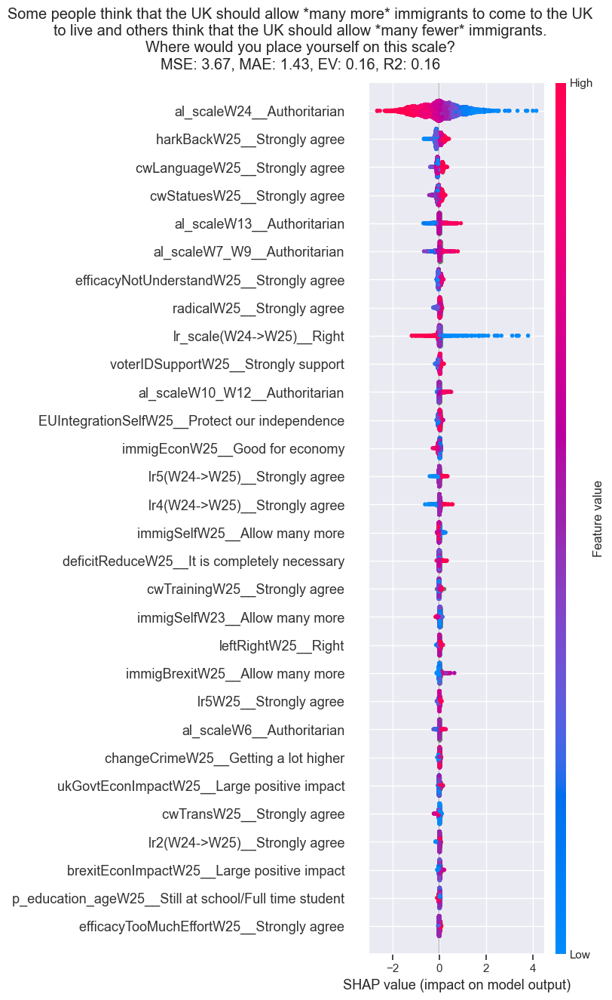

Wall time: 2min 32s


In [306]:
%%time
# 
name= "al_scale(W24->W25)__Authoritarian"
stub_list = [name,"al_scaleW25__Authoritarian",
             "al1","al2","al3","al4","al5",
             "al_scale(","al_scaleW23","al_scaleW22","al_scaleW21","al_scaleW20","al_scaleW19",
             "al_scaleW17","al_scaleW16","al_scaleW14","al_scaleW13","al_scaleW10","al_scaleW7",
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 4.26, MAE: 1.55, EV: 0.28, R2: 0.28


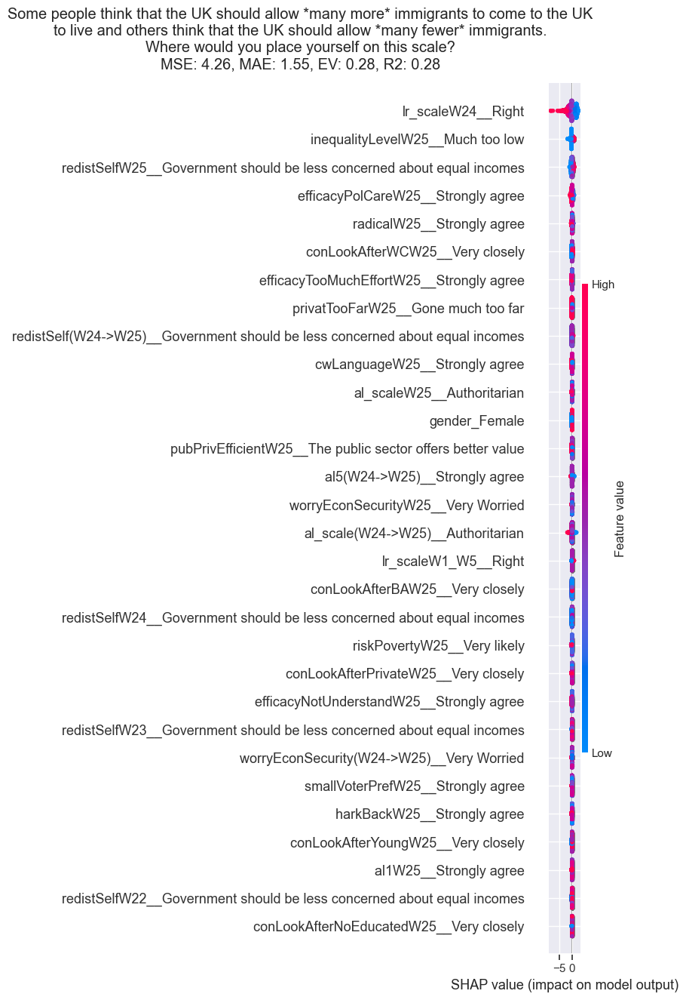

Wall time: 3min 45s


In [312]:
%%time
# 
name= "lr_scale(W24->W25)__Right"
stub_list = [name,"lr_scaleW25__Right",
             "lr1","lr2","lr3","lr4","lr5",
             "lr_scale(","lr_scaleW23","lr_scaleW23","lr_scaleW22","lr_scaleW21","lr_scaleW20",
             "lr_scaleW19","lr_scaleW17","lr_scaleW16","lr_scaleW14","lr_scaleW13","lr_scaleW10","lr_scaleW7",
             "lr_scaleW16"
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

MSE: 7.35, MAE: 2.03, EV: 0.12, R2: 0.12


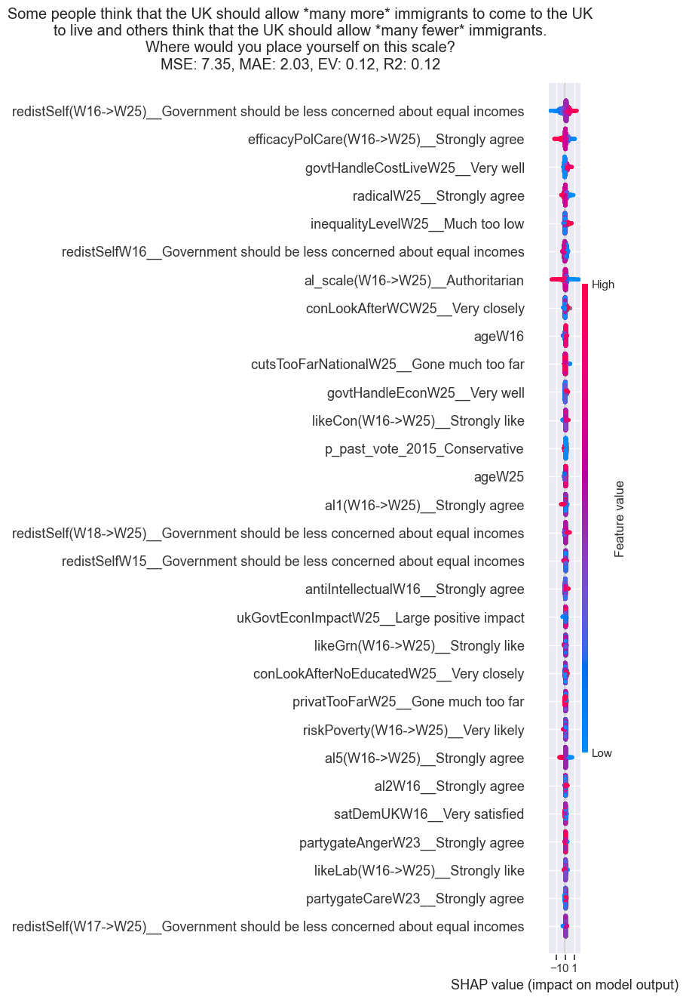

Wall time: 2min 11s


In [311]:
%%time
# 
name= "lr_scale(W16->W25)__Right"
stub_list = [name,"lr_scaleW25__Right",
             "lr1","lr2","lr3","lr4","lr5",
             "lr_scale(","lr_scaleW24","lr_scaleW23","lr_scaleW22","lr_scaleW21","lr_scaleW20",
             "lr_scaleW19","lr_scaleW17","lr_scaleW14","lr_scaleW13","lr_scaleW10","lr_scaleW7",
             "lr_scaleW16"
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [313]:
## all seems to boil down to one connection (auth-left/lib-right shift axis!) (and some close correlates)

In [316]:
search(BES_reduced_with_na,"changeImmig")

changeImmigW1__Getting a lot higher            28952
changeImmigLabW1__Getting a lot higher         27027
changeImmigW2__Getting a lot higher            29354
changeImmigLabW2__Getting a lot higher         27408
changeImmigW3__Getting a lot higher            26281
changeImmigLabW3__Getting a lot higher         24423
changeImmigW4__Getting a lot higher            29867
changeImmigLabW4__Getting a lot higher         27722
changeImmigW7__Getting a lot higher            29200
changeImmigLabW7__Getting a lot higher         27084
changeImmigW8__Getting a lot higher            32183
changeImmigW10__Getting a lot higher           27626
changeImmigLabW10__Getting a lot higher        25228
changeImmigW11__Getting a lot higher           28374
changeImmigW14__Getting a lot higher           27571
changeImmigW15__Getting a lot higher           27283
changeImmigW16__Getting a lot higher           33309
changeImmigW17__Getting a lot higher           30436
changeImmigW25__Getting a lot higher          

MSE: 0.48, MAE: 0.52, EV: 0.66, R2: 0.66


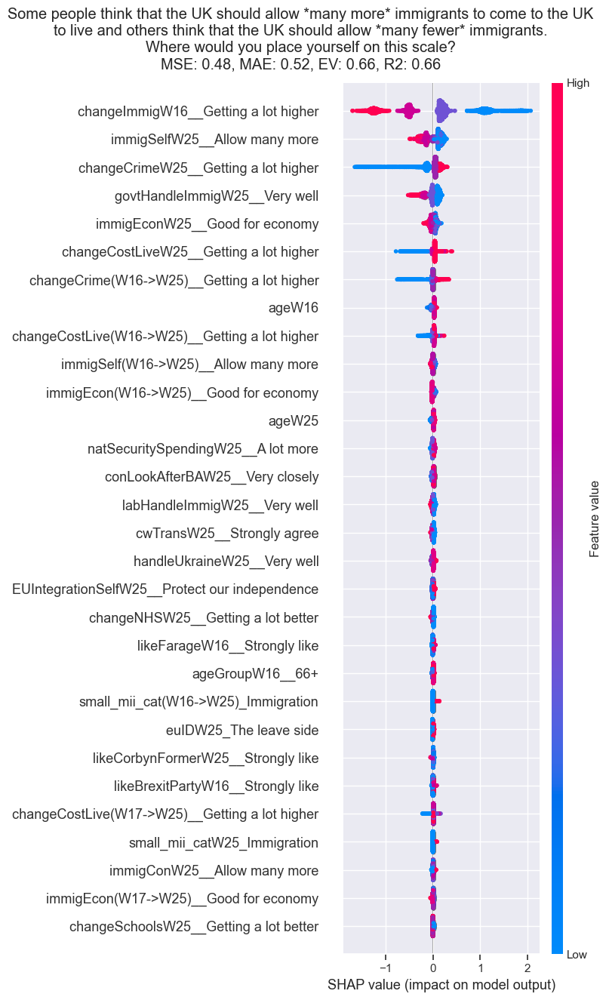

Wall time: 3min 38s


In [317]:
%%time
# 
name= "changeImmig(W16->W25)__Getting a lot higher"
stub_list = [name,"changeImmigW25__Getting a lot higher",
            "changeImmigW17__Getting a lot higher","changeImmigW15__Getting a lot higher","changeImmigW14__Getting a lot higher",
             "changeImmigW10__Getting a lot higher","changeImmigW8__Getting a lot higher","changeImmigW7__Getting a lot higher",
             "changeImmigLabr","changeImmigW4__Getting a lot higher","changeImmigW3__Getting a lot higher",
             "changeImmigW2__Getting a lot higher","changeImmigW1__Getting a lot higher",
             "changeImmig(W17->W25)__Getting a lot higher"
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [318]:
search(BES_reduced_with_na,"asylumMore")
# note low numbers in post W13 waves!

asylumMoreW7__Many more            28414
asylumMoreW8__Many more            31101
asylumMoreW13__Many more           28447
asylumMoreW20__Many more            6951
asylumMoreW25__Many more            6942
asylumMore(W20->W25)__Many more     2211
dtype: int64

MSE: 2.71, MAE: 1.15, EV: 0.37, R2: 0.37


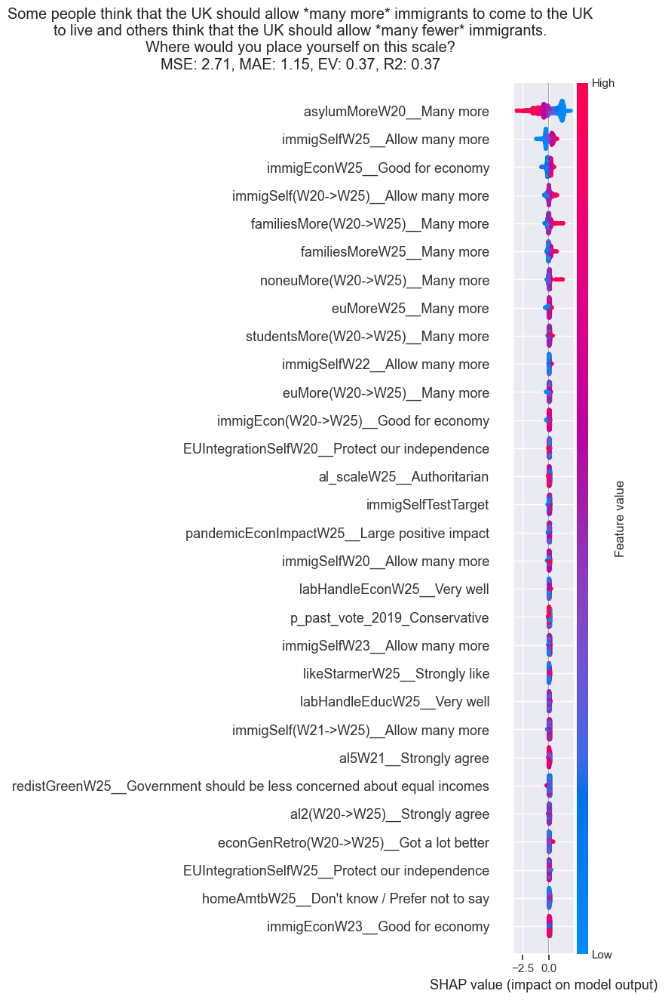

Wall time: 1min 21s


In [321]:
%%time
# 
name= "asylumMore(W20->W25)__Many more"
stub_list = [name,"changeImmigW25__Getting a lot higher",
            "asylumMoreW25__Many more","asylumMoreW13__Many more","asylumMoreW8__Many more",
             "asylumMoreW7__Many more",
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##

In [320]:
search(BES_reduced_with_na,"taxSpendSelf").index

Index(['taxSpendSelfW14__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW15__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW20__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW21__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW22__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW23__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW25__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelf(W20->W25)__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelf(W21->W25)__Government should increase taxes 

MSE: 2.77, MAE: 1.21, EV: 0.33, R2: 0.33


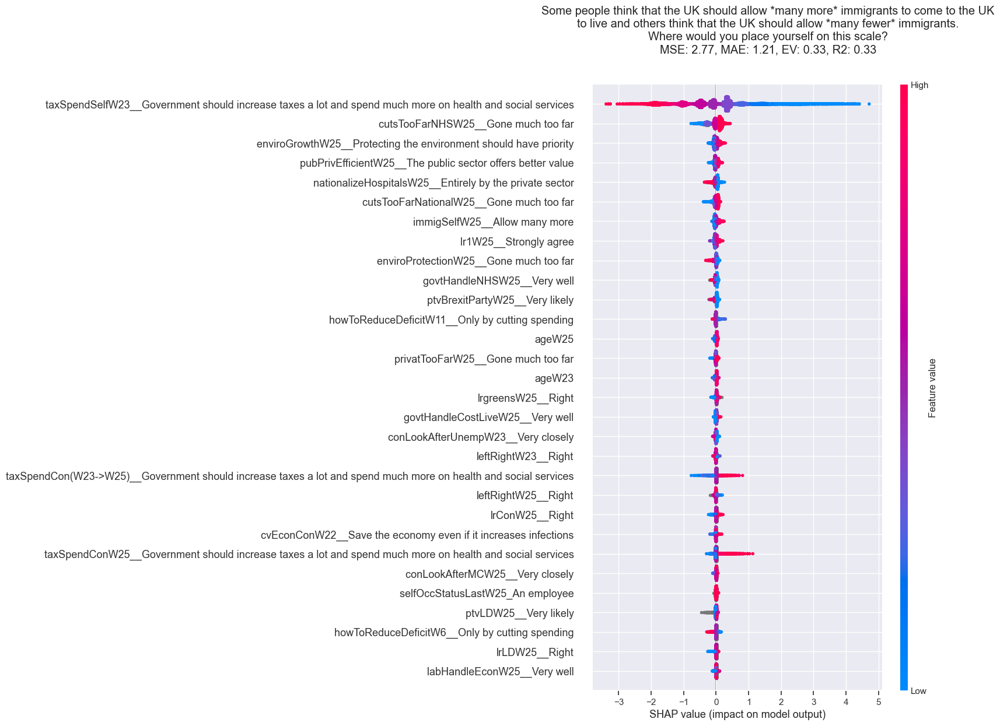

Wall time: 5min 8s


In [322]:
%%time
# 
name= "taxSpendSelf(W23->W25)__Government should increase taxes a lot and spend much more on health and social services"
stub_list = [name,
            'taxSpendSelfW14__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW15__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW20__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW21__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW22__Government should increase taxes a lot and spend much more on health and social services',
#        'taxSpendSelfW23__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelfW25__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelf(W20->W25)__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelf(W21->W25)__Government should increase taxes a lot and spend much more on health and social services',
       'taxSpendSelf(W22->W25)__Government should increase taxes a lot and spend much more on health and social services',
#        'taxSpendSelf(W23->W25)__Government should increase taxes a lot and spend much more on health and social services'
            ]
# stub_list = [name,"immigConW25__Allow many more"]

# mask = BES_reduced_with_na["immigSelfW23__Allow many more"].isin([3,4])
# mask = mask & (BES_reduced_with_na["immigSelf(W23->W25)__Allow many more"].abs()<=3)
# mask = mask & (BES_reduced_with_na["likeConW25__Strongly like"]>1)
# print(mask.sum())
(explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics) = xgboost_run(
    title = "Some people think that the UK should allow *many more* immigrants to come to the UK\nto live and others think that the UK should allow *many fewer* immigrants.\nWhere would you place yourself on this scale?",
    dataset=BES_reduced_with_na,
                                                    var_list = [name],var_stub_list = stub_list,verbosity=0)

##